# Training Custom ResNet
___

## Table of contents
1. [Imports](#Imports)
2. [LoadData](#LoadData)
3. [Config](#Configs)
4. [Analysis](#Analysis)
5. [Process](#Process)

## Imports

In [1]:
import os
import numpy as np
import pandas as pd

import optuna
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F

from torch.utils.data import Dataset,DataLoader,random_split
from torch.utils.tensorboard import SummaryWriter
import torchvision
from torchvision import models, transforms
from torch_lr_finder import LRFinder

from tqdm.notebook import tqdm

import math
import pretrainedmodels as ptm
import h5py
import copy
from datetime import datetime
import matplotlib.pyplot as plt

In [2]:
from Library.datasets import DatasetH5TwoRandom, DatasetH5ForTest, compute_std_mean
from Library.transforms import RandomFlip,RandomOffset,RandomRotateGrayscale
from Library.scheduler import OneCycleLR,LogLR
from Library.cresnet import initialize_cresnet
from Library.dml import RefBasedDeepMetric
from Library.models.FeatureExtractor import FeatureExtractor, Block, CustomNet
from Library.trainers import RefBasedDeepMetricTrainer

In [3]:
from Library.util import (
    jupyter_wide_screen,
    strings_contain_words, 
    strings_contain_patterns, 
    add_unique_entry
)

jupyter_wide_screen()

## LoadData

#### To initialize dataset: obtain References and Dataset object

In [5]:
def init_dataset(path,seq_idx_list,mean_val,std_val):

    ds_h5 = []
    refs_list = []

    img_transforms = [RandomRotateGrayscale(rot_range=[-0.1, 0.1], fill=150),                       
                      RandomFlip(lr_prob=0.5, ud_prob=0.5),
                      transforms.ToTensor(),
                      transforms.Normalize((mean_val,),(std_val,))]
    
    composed_img_transforms = transforms.Compose(img_transforms)
    
    # to obtain the Seq data
    for seq_idx in seq_idx_list:
        h5_fpath = path.format(seq_idx)
        h5_f = DatasetH5TwoRandom(h5_fpath, num_ref = 32, transform = composed_img_transforms)
        
        # obtain the references, the first 32 images in every Seq.
        refs = h5_f.getRef()
        refs_list.append(refs)
        
        ds_h5.append(h5_f)

    return refs_list, ds_h5

In [6]:
def init_dataloaders(datasets,ds_ratio):
    dataloaders = []
    
    for ds in datasets:
        splitted_ds_num_data = [round(len(ds) * ds_ratio[i]) for i in range(len(ds_ratio))]
        splitted_ds_num_data[0] += len(ds) - int(np.sum(splitted_ds_num_data))

        splitted_ds = []

        for tmp_ds, batch_size, shuffle in zip(random_split(ds, splitted_ds_num_data), batch_sizes, shuffle_flags):

            splitted_ds.append(
                DataLoader(
                    tmp_ds,
                    batch_size=batch_size,
                    shuffle=shuffle,
                    drop_last=True,
                )
            )

        dataloaders.append(splitted_ds)
    return dataloaders


## Load Data
### Config

#### Load 720x24 3 Stripes Data from /22008_1000202026_652510007

In [7]:
data_path_type1 = "../MA/NewData/22008_1000202026_652510007"
fnames_type1 = "Padding_regenerated_roi_ms1_seq{}_720x24.h5" # 0,1,2,3,4,5,6
combined_path_type1 = os.path.join(data_path_type1, fnames_type1)
seq_idx_list_type1 = [0,1,2,3,4,5,6]

#### Load 1 Stripe Data from /21503_1000200411_653340003 If need

In [ ]:
# type 2 Data New regenerated data
data_path_type2 = "../MA/NewData/21503_1000200411_653340003"
fnames_type2 = "regenerated_roi_ms1_seq{}_720x30.h5" # 2,3,4
combined_path_type2 = os.path.join(data_path_type2, fnames_type2)
seq_idx_list_type2 = [2,3,5,6]

In [8]:
inputs_shape = [1,720,24]
batch_sizes = [32, 32]
shuffle_flags = [True, False]
ds_ratio = [0.8, 0.2]

### Initialize datasets

In [12]:
# For 3 stripes data
mean_val = 0
std_val = 255
refs_list, ds_h5 = init_dataset(combined_path_type1, seq_idx_list_type1, mean_val, std_val)

In [13]:
len(refs_list)

7

In [11]:
refs_list[0] = refs_list[2]
refs_list[1] = refs_list[2]

In [ ]:
refs_list[0][2] == refs_list[1][2]

### Initialize dataloaders

In [14]:
dataloaders = init_dataloaders(ds_h5, ds_ratio)
train_dls = [dls[0] for dls in dataloaders]
valid_dls = [dls[1] for dls in dataloaders]

In [15]:
ds_h5

In [16]:
len(refs_list)

7

In [17]:
refs_list[0].shape

torch.Size([32, 1, 720, 24])

In [18]:
print(len(ds_h5[0]))
print(len(ds_h5[1]))
print(len(ds_h5[2]))
print(len(ds_h5[3]))

1969
2427
6797
4402


## FeatureExtractor

In [19]:
class FeatureExtractor(nn.Module):
    # Custom feature extraction model from pretrained ResNet50

    def __init__(self, model,zero_init_residual=False):
        super(FeatureExtractor, self).__init__()
        
        self.conv1= nn.Conv2d(1, 64, 3, (2,1), 1)
        self.bn1 = model.bn1
        self.relu = nn.LeakyReLU()
        self.maxpool = model.maxpool

        self.layer1 = model.layer1
        self.layer2 = model.layer2

        self.avgpool = nn.AdaptiveAvgPool2d((1,1))
        self.fc = nn.Sequential(nn.Linear(512, 128),
                                nn.Linear(128, 64))
                                
                
        # weights initialization
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            elif isinstance(m, nn.BatchNorm2d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)
            elif isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight, mode = 'fan_in', nonlinearity = 'leaky_relu')

        # Zero-initialize the last BN in each residual branch,
        # so that the residual branch starts with zeros, and each residual block behaves like an identity.
        # This improves the model by 0.2~0.3% according to https://arxiv.org/abs/1706.02677
        if zero_init_residual:
            for m in self.modules():
                if isinstance(m, Bottleneck):
                    nn.init.constant_(m.bn3.weight, 0)
                elif isinstance(m, BasicBlock):
                    nn.init.constant_(m.bn2.weight, 0)

    def forward(self, x):

        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)
        
        self.featuremap0 = x.detach() # 核心代码

        x = self.layer1(x)
        self.featuremap1 = x.detach() # 核心代码
        
        x = self.layer2(x)
        self.featuremap2 = x.detach() # 核心代码
        
        x = self.avgpool(x)
        x = x.reshape(x.shape[0], -1)

        x = self.fc(x)
        self.featuremapfc = x.detach() # 核心代码
        
        # 使用的时候 : feature_output1 = model.featuremap1.transpose(1,0).cpu()
        
        return x
    
    def show_intermediate_shape(self, x):
        x = self.conv1(x)
        print("In conv1: ", x.shape)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)
        print("In maxpool: ", x.shape)
        x = self.layer1(x)
        print("In layer1: ", x.shape)
        x = self.layer2(x)
        print("In layer2: ", x.shape)
        
        x = self.avgpool(x)
        x = x.reshape(x.shape[0], -1)
        x = self.fc(x)
        print("In FC: ", x.shape)

## SiameseNet structure

In [ ]:
class SiameseNet(nn.Module):
    def __init__(self, model):
        super(SiameseNet, self).__init__()
        self.model = model
        
    def _calculate_loss(self, v1, v2, refs_tensor):
        r"""Calculate distance between vector of img1&img2 and each reference images

        Args:
            v1 (Tensor, torch.Size[batchsize,128]): batch of img1s from feature extractor
            v2 (Tensor, torch.Size[batchsize,128]): batch of img2s from feature extractor
            refs_vectors(List of Tensor, torch.Size([1,128])): List of 10 refs vectors
        """
        v_dim = v1.size(1)
        num_ref = refs_tensor.size(0)

        v11 = v1.unsqueeze(1).repeat(1, num_ref, 1)
        v22 = v2.unsqueeze(1).repeat(1, num_ref, 1)
        refs = refs_tensor.unsqueeze(0).repeat(v1.size(0), 1, 1)  #v1.size(0) = batch size

        kernel_matrix1 = (v11-refs).pow(2).sum(2) #torch.Size([batchsize, 10])
        kernel_matrix2 = (v22-refs).pow(2).sum(2) #torch.Size([batchsize, 10])

        v1_distance_mean = torch.mean(kernel_matrix1,dim = 1) #torch.Size([batchsize])
        v2_distance_mean = torch.mean(kernel_matrix2,dim = 1) #torch.Size([batchsize])
        
        diff = v1_distance_mean - v2_distance_mean
        
        #print("Before Sigmoid outputs",outputs)
        sigmoid = nn.Sigmoid()
        outputs = sigmoid(diff)
        #print("After Sigmoid outputs",outputs)

        return outputs

    def forward(self, x1, x2, refs):
        v1 = self.model(x1)
        v2 = self.model(x2)
        feature_refs = self.model(refs)
        
        outputs = self._calculate_loss(v1, v2, feature_refs)
        return outputs
    
    # This function used to plot the degradation metric , x1 is the sequential image
    def forward_test(self, x1, refs):
        v1 = self.model(x1)
        feature_refs = self.model(refs)
        
        return v1, feature_refs
    
    def get_model(self, x):
        return self.model(x)



#### Load pretrained ResNet

In [20]:
res_model = models.resnet50(pretrained=True)
feature_extractor = FeatureExtractor(res_model)
model = RefBasedDeepMetric(feature_extractor,loss_non_linearity_name='sigmoid',criterion_name='bce',)
#model = SiameseNet(feature_extractor)
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model.to(device)

RefBasedDeepMetric(
  (feature_extractor): FeatureExtractor(
    (conv1): Conv2d(1, 64, kernel_size=(3, 3), stride=(2, 1), padding=(1, 1))
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): LeakyReLU(negative_slope=0.01)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (down

In [ ]:
x = torch.randn(1,1,720,30)

model.model.show_intermediate_shape(x.to(device))

## Learning Rate Test

In [21]:
from torch.optim.lr_scheduler import _LRScheduler
from torch_lr_finder import LRFinder ,TrainDataLoaderIter, ValDataLoaderIter

In [22]:
class CustomTrainIter(TrainDataLoaderIter):
    def inputs_labels_from_batch(self, batch_data):
        img1, img2, labels = batch_data
        return img1, img2, labels
    
    def __next__(self):
        try:
            batch = next(self._iterator)
            img1, img2, labels = self.inputs_labels_from_batch(batch)
        except StopIteration:
            if not self.auto_reset:
                raise
            self._iterator = iter(self.data_loader)
            batch = next(self._iterator)
            img1, img2, labels = self.inputs_labels_from_batch(batch)

        return img1, img2, labels

In [23]:
class CustomValIter(ValDataLoaderIter):
    def inputs_labels_from_batch(self, batch_data):
        img1, img2, labels = batch_data
        return img1, img2, labels

In [24]:
class LinearLR(_LRScheduler):
    """Linearly increases the learning rate between two boundaries over a number of
    iterations.

    Arguments:
        optimizer (torch.optim.Optimizer): wrapped optimizer.
        end_lr (float): the final learning rate.
        num_iter (int): the number of iterations over which the test occurs.
        last_epoch (int, optional): the index of last epoch. Default: -1.
    """

    def __init__(self, optimizer, end_lr, num_iter, last_epoch=-1):
        self.end_lr = end_lr

        if num_iter <= 1:
            raise ValueError("`num_iter` must be larger than 1")
        self.num_iter = num_iter

        super(LinearLR, self).__init__(optimizer, last_epoch)

    def get_lr(self):
        r = self.last_epoch / (self.num_iter - 1)

        return [base_lr + r * (self.end_lr - base_lr) for base_lr in self.base_lrs]

In [25]:
class ExponentialLR(_LRScheduler):
    """Exponentially increases the learning rate between two boundaries over a number of
    iterations.

    Arguments:
        optimizer (torch.optim.Optimizer): wrapped optimizer.
        end_lr (float): the final learning rate.
        num_iter (int): the number of iterations over which the test occurs.
        last_epoch (int, optional): the index of last epoch. Default: -1.
    """

    def __init__(self, optimizer, end_lr, num_iter, last_epoch=-1):
        self.end_lr = end_lr

        if num_iter <= 1:
            raise ValueError("`num_iter` must be larger than 1")
        self.num_iter = num_iter

        super(ExponentialLR, self).__init__(optimizer, last_epoch)

    def get_lr(self):
        # In earlier Pytorch versions last_epoch starts at -1, while in recent versions
        # it starts at 0. We need to adjust the math a bit to handle this. See
        # discussion at: https://github.com/davidtvs/pytorch-lr-finder/pull/42
        
        r = self.last_epoch / (self.num_iter - 1)

        return [base_lr * (self.end_lr / base_lr) ** r for base_lr in self.base_lrs]

In [26]:
try:
    from apex import amp

    IS_AMP_AVAILABLE = True
except ImportError:
    IS_AMP_AVAILABLE = False
    
class CustomLRFinder(LRFinder):
    
    def custom_range_test(
        self,
        train_loader,
        curr_refs,
        val_loader=None,
        start_lr=None,
        end_lr=10,
        num_iter=100,
        step_mode="exp",
        smooth_f=0.05,
        diverge_th=5,
        accumulation_steps=1,
        non_blocking_transfer=True,
    ):
       
        # Reset test results
        self.history = {"lr": [], "loss": []}
        self.best_loss = None

        # Move the model to the proper device
        self.model.to(self.device)

        # Check if the optimizer is already attached to a scheduler
        self._check_for_scheduler()

        # Set the starting learning rate
        if start_lr:
            self._set_learning_rate(start_lr)

        # Initialize the proper learning rate policy
        if step_mode.lower() == "exp":
            lr_schedule = ExponentialLR(self.optimizer, end_lr, num_iter)
        elif step_mode.lower() == "linear":
            lr_schedule = LinearLR(self.optimizer, end_lr, num_iter)
        else:
            raise ValueError("expected one of (exp, linear), got {}".format(step_mode))

        if smooth_f < 0 or smooth_f >= 1:
            raise ValueError("smooth_f is outside the range [0, 1[")

        # Create an iterator to get data batch by batch
        if isinstance(train_loader, DataLoader):
            train_iter = TrainDataLoaderIter(train_loader)
        elif isinstance(train_loader, TrainDataLoaderIter):
            train_iter = train_loader
        else:
            raise ValueError(
                "`train_loader` has unsupported type: {}."
                "Expected types are `torch.utils.data.DataLoader`"
                "or child of `TrainDataLoaderIter`.".format(type(train_loader))
            )

        if val_loader:
            if isinstance(val_loader, DataLoader):
                val_iter = CustomValIter(val_loader)
            elif isinstance(val_loader, ValDataLoaderIter):
                val_iter = val_loader
            else:
                raise ValueError(
                    "`val_loader` has unsupported type: {}."
                    "Expected types are `torch.utils.data.DataLoader`"
                    "or child of `ValDataLoaderIter`.".format(type(val_loader))
                )

        for iteration in tqdm(range(num_iter)):
            # Train on batch and retrieve loss
            loss = self._train_batch(
                train_iter,
                curr_refs,
                accumulation_steps,
                non_blocking_transfer= non_blocking_transfer,
            )
            if val_loader:
                loss = self._validate(
                    val_iter, curr_refs, non_blocking_transfer=non_blocking_transfer
                )

            # Update the learning rate
            self.history["lr"].append(lr_schedule.get_lr()[0])
            lr_schedule.step()

            # Track the best loss and smooth it if smooth_f is specified
            if iteration == 0:
                self.best_loss = loss
            else:
                if smooth_f > 0:
                    loss = smooth_f * loss + (1 - smooth_f) * self.history["loss"][-1]
                if loss < self.best_loss:
                    self.best_loss = loss

            # Check if the loss has diverged; if it has, stop the test
            self.history["loss"].append(loss)
            if loss > diverge_th * self.best_loss:
                print("Stopping early, the loss has diverged")
                break

        print("Learning rate search finished. See the graph with {finder_name}.plot()")

    def _train_batch(self, train_iter, curr_refs, accumulation_steps, non_blocking_transfer=True):
        self.model.train()
        total_loss = None  # for late initialization
        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        self.optimizer.zero_grad()
        curr_refs = curr_refs.float().to(device)

        for i in range(accumulation_steps):
            img1, img2, labels = next(train_iter)
            labels = labels.view(-1)
            labels = labels.to(device)
            img1 = img1.float().to(device)
            img2 = img2.float().to(device)

            # Forward pass
            loss, preds = self.model.compute_loss(img1, img2, curr_refs, labels)

            # Loss should be averaged in each step
            loss /= accumulation_steps

            # Backward pass
            if IS_AMP_AVAILABLE and hasattr(self.optimizer, "_amp_stash"):
                # For minor performance optimization, see also:
                # https://nvidia.github.io/apex/advanced.html#gradient-accumulation-across-iterations
                delay_unscale = ((i + 1) % accumulation_steps) != 0

                with amp.scale_loss(
                    loss, self.optimizer, delay_unscale=delay_unscale
                ) as scaled_loss:
                    scaled_loss.backward()
            else:
                loss.backward()

            if total_loss is None:
                total_loss = loss
            else:
                total_loss += loss

        self.optimizer.step()

        return total_loss.item()
    
    def _validate(self, val_iter, curr_refs, non_blocking_transfer=True):
        # Set model to evaluation mode and disable gradient computation
        running_loss = 0
        self.model.eval()
        
        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        curr_refs = curr_refs.float().to(device)
        with torch.no_grad():
            for img1, img2, labels in val_iter:
                # Move data to the correct device
                labels = labels.view(-1)
                labels = labels.to(device)
                img1 = img1.float().to(device)
                img2 = img2.float().to(device)

                # Forward pass and loss computation
                loss, preds = self.model.compute_loss(img1, img2, curr_refs, labels)
                running_loss += loss.item() * len(labels)

        return running_loss / len(val_iter.dataset)
    

### LR Test Config

In [27]:
start_lr = 1e-8

min_lr_factor = 1e-1
anneal_lr_factor= 1e-1

train_dl_idx = 0
valid_dl_idx = 1
test_dl_idx = 2
refs_dl_idx = 0

optimizer = torch.optim.Adam(model.parameters(),lr=start_lr, eps=1e-08, weight_decay=0)
#optimizer = torch.optim.SGD(filter(lambda p: p.requires_grad, model.parameters()), lr=lr, momentum=0.5)
#criterion = nn.CrossEntropyLoss()
#criterion = nn.BCEWithLogitsLoss(reduction = 'none')
criterion = nn.BCELoss()


Learning rate search finished. See the graph with {finder_name}.plot()
LR suggestion: steepest gradient
Suggested LR: 8.91E-08


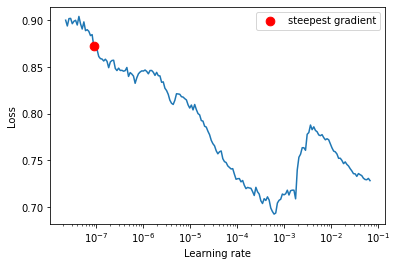

In [28]:
#lr_finder.reset()
lr_finder = CustomLRFinder(model, optimizer, criterion, device="cuda")

# seq dataloader / shuffel the dataloader
for refs, train_dl, val_dl in zip (refs_list, train_dls, valid_dls):
    custom_train_iter = CustomTrainIter(train_dl)
    custom_val_iter = CustomValIter(val_dl)
lr_finder.custom_range_test(custom_train_iter, curr_refs = refs, end_lr=0.1, num_iter=200)
lr_finder.plot()
lr_finder.reset()

## To see the intmediate feature

In [ ]:
feature_output1 = model.model.featuremap1.transpose(1,0).cpu()
feature_output2 = model.model.featuremap2.transpose(1,0).cpu()
#feature_output3 = model.model.featuremap3.transpose(1,0).cpu()
#feature_output4 = model.model.featuremap4.transpose(1,0).cpu()
#feature_output_fc = model.model.featuremapfc.transpose(1,0).cpu()
feature_output2.shape

In [ ]:
def feature_imshow(inp, title=None):
    
    """Imshow for Tensor."""
    
    inp = inp.detach().numpy().transpose((1, 2, 0))
    
    mean = np.array([0.5, 0.5, 0.5])
    
    std = np.array([0.5, 0.5, 0.5])
    
    inp = std * inp + mean
    
    inp = np.clip(inp, 0, 1)
    
    plt.imshow(inp)
    
    if title is not None:
        plt.title(title)
    
    plt.pause(0.001)  # pause a bit so that plots are updated

In [ ]:
out = torchvision.utils.make_grid(feature_output1)
#feature_imshow(out)


## Training Config

In [29]:
num_epochs = 50

lr = 5e-05
min_lr_factor = 0.1
phases_ratio = [0.3, 0.2, 0.3, 0.2]

train_dl_idx = 0
valid_dl_idx = 1
test_dl_idx = 2

run_train = True

net_path = "../MA/save_net/"
criterion = nn.BCELoss()
def get_lr(optimizer):
    for param_group in optimizer.param_groups:
        return param_group['lr']
    
dateTimeObj = datetime.now()
timestampStr = dateTimeObj.strftime("%d-%b-%Y (%H:%M:%S)")
print('Current Timestamp : ', timestampStr)

Current Timestamp :  19-May-2021 (11:39:34)


### Train

Total Train Iterations:  695
Total Train Iterations List:  [49, 109, 229, 339, 459, 575, 695]
[16, 20, 40, 37, 40, 38, 40]


Train



Sequence:1, Seq Training Mean Loss: 0.3170350268483162, Seq Training Acc: 0.20234375
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3624234989285469, Seq Training Acc: 0.24973958333333332
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.7208047151565552, Seq Training Acc: 0.49557291666666664
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.6594781165321668, Seq Training Acc: 0.4427083333333333
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6907513047258059, Seq Training Acc: 0.5338541666666666
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.6729236414035161, Seq Training Acc: 0.5153645833333333
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.6965696930885314, Seq Training Acc: 0.52265625
******************************************************************
Epoch:1, Epoch Training Loss Mean: 0.7113645076751709, Epoch Acc: 0.9874131944444444
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.7107115909457207, Seq Val Acc: 0.517578125



******************************************************************
Sequence:2, Seq Mean Loss: 0.6838168144226074, Seq Val Acc: 0.5578125



******************************************************************
Sequence:3, Seq Mean Loss: 0.7043952122330666, Seq Val Acc: 0.53671875



******************************************************************
Sequence:4, Seq Mean Loss: 0.7194373140463958, Seq Val Acc: 0.48817567567567566



******************************************************************
Sequence:5, Seq Mean Loss: 0.6902546048164367, Seq Val Acc: 0.54375



******************************************************************
Sequence:6, Seq Mean Loss: 0.6813948264247492, Seq Val Acc: 0.5641447368421053



******************************************************************
Sequence:7, Seq Mean Loss: 0.6667777642607688, Seq Val Acc: 0.6
Epoch:1, Epoch Val Mean Loss: 0.692714273929596, Epoch Val Acc: 1.0513020833333333
******************************************************************


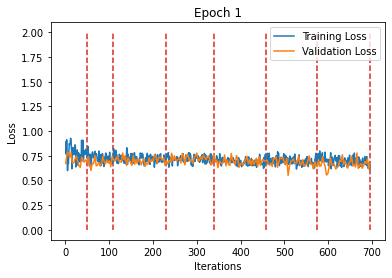

Train



Sequence:1, Seq Training Mean Loss: 0.290580977499485, Seq Training Acc: 0.20026041666666666
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3382660855849584, Seq Training Acc: 0.28229166666666666
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.7010378743211428, Seq Training Acc: 0.5138020833333333
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.649346209069093, Seq Training Acc: 0.453125
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6804148554801941, Seq Training Acc: 0.5625
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.6638957296808561, Seq Training Acc: 0.5325520833333334
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.6409058642884096, Seq Training Acc: 0.625
******************************************************************
Epoch:2, Epoch Training Loss Mean: 0.6845089197158813, Epoch Acc: 1.0565104166666666
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.745179183781147, Seq Val Acc: 0.427734375



******************************************************************
Sequence:2, Seq Mean Loss: 0.6028004586696625, Seq Val Acc: 0.671875



******************************************************************
Sequence:3, Seq Mean Loss: 0.7291947469115257, Seq Val Acc: 0.490625



******************************************************************
Sequence:4, Seq Mean Loss: 0.7184130919946207, Seq Val Acc: 0.5194256756756757



******************************************************************
Sequence:5, Seq Mean Loss: 0.6723907649517059, Seq Val Acc: 0.5734375



******************************************************************
Sequence:6, Seq Mean Loss: 0.6985225144185518, Seq Val Acc: 0.5822368421052632



******************************************************************
Sequence:7, Seq Mean Loss: 0.5995814189314842, Seq Val Acc: 0.68046875
Epoch:2, Epoch Val Mean Loss: 0.6803060173988342, Epoch Val Acc: 1.0950520833333333
******************************************************************


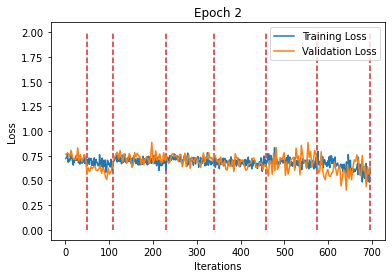

Train



Sequence:1, Seq Training Mean Loss: 0.28682472854852675, Seq Training Acc: 0.21380208333333334
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2954289987683296, Seq Training Acc: 0.3484375
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.7050372163454691, Seq Training Acc: 0.5307291666666667
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.6460564111669859, Seq Training Acc: 0.47161458333333334
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6837664390603702, Seq Training Acc: 0.546875
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.6499672785401345, Seq Training Acc: 0.5635416666666667
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.5621477129558722, Seq Training Acc: 0.7104166666666667
******************************************************************
Epoch:3, Epoch Training Loss Mean: 0.6611617803573608, Epoch Acc: 1.1284722222222223
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.7621308527886868, Seq Val Acc: 0.466796875



******************************************************************
Sequence:2, Seq Mean Loss: 0.5675098046660423, Seq Val Acc: 0.6875



******************************************************************
Sequence:3, Seq Mean Loss: 0.7099011063575744, Seq Val Acc: 0.5375



******************************************************************
Sequence:4, Seq Mean Loss: 0.7407169744775102, Seq Val Acc: 0.5152027027027027



******************************************************************
Sequence:5, Seq Mean Loss: 0.6610600709915161, Seq Val Acc: 0.5984375



******************************************************************
Sequence:6, Seq Mean Loss: 0.677201697700902, Seq Val Acc: 0.6044407894736842



******************************************************************
Sequence:7, Seq Mean Loss: 0.5132953830063343, Seq Val Acc: 0.7453125
Epoch:3, Epoch Val Mean Loss: 0.6582456827163696, Epoch Val Acc: 1.1541666666666666
******************************************************************


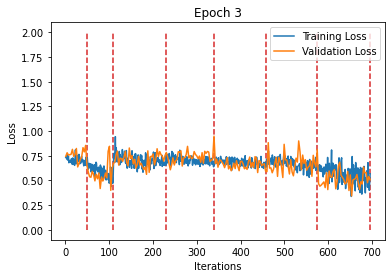

Train



Sequence:1, Seq Training Mean Loss: 0.2852369020382563, Seq Training Acc: 0.21770833333333334
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.26883637309074404, Seq Training Acc: 0.3684895833333333
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.7032507727543513, Seq Training Acc: 0.5333333333333333
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.6430712774395942, Seq Training Acc: 0.47682291666666665
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.670943745970726, Seq Training Acc: 0.57578125
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.6283138796687127, Seq Training Acc: 0.5966145833333333
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.5428249940276146, Seq Training Acc: 0.7294270833333333
******************************************************************
Epoch:4, Epoch Training Loss Mean: 0.6461832523345947, Epoch Acc: 1.1660590277777778
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.7672681212425232, Seq Val Acc: 0.4453125



******************************************************************
Sequence:2, Seq Mean Loss: 0.6199581444263458, Seq Val Acc: 0.6421875



******************************************************************
Sequence:3, Seq Mean Loss: 0.7924465924501419, Seq Val Acc: 0.4671875



******************************************************************
Sequence:4, Seq Mean Loss: 0.7750068838531906, Seq Val Acc: 0.518581081081081



******************************************************************
Sequence:5, Seq Mean Loss: 0.70508903414011, Seq Val Acc: 0.578125



******************************************************************
Sequence:6, Seq Mean Loss: 0.7402013712807706, Seq Val Acc: 0.5978618421052632



******************************************************************
Sequence:7, Seq Mean Loss: 0.551092553883791, Seq Val Acc: 0.71328125
Epoch:4, Epoch Val Mean Loss: 0.7074609994888306, Epoch Val Acc: 1.1018229166666667
******************************************************************


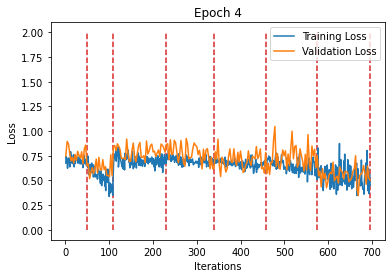

Train



Sequence:1, Seq Training Mean Loss: 0.28126761813958484, Seq Training Acc: 0.22864583333333333
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2532419376075268, Seq Training Acc: 0.38359375
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.7003396297494571, Seq Training Acc: 0.5315104166666667
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.6332179059584936, Seq Training Acc: 0.48776041666666664
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6569294060269991, Seq Training Acc: 0.5921875
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.6002981305122376, Seq Training Acc: 0.6369791666666667
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.548860884954532, Seq Training Acc: 0.73671875
******************************************************************
Epoch:5, Epoch Training Loss Mean: 0.6343865990638733, Epoch Acc: 1.1991319444444444
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.734223660081625, Seq Val Acc: 0.46875



******************************************************************
Sequence:2, Seq Mean Loss: 0.5677914649248124, Seq Val Acc: 0.7078125



******************************************************************
Sequence:3, Seq Mean Loss: 0.7564217656850815, Seq Val Acc: 0.51328125



******************************************************************
Sequence:4, Seq Mean Loss: 0.7677325574127404, Seq Val Acc: 0.5253378378378378



******************************************************************
Sequence:5, Seq Mean Loss: 0.6825119212269783, Seq Val Acc: 0.5953125



******************************************************************
Sequence:6, Seq Mean Loss: 0.6939687038722792, Seq Val Acc: 0.6118421052631579



******************************************************************
Sequence:7, Seq Mean Loss: 0.5102025374770165, Seq Val Acc: 0.75234375
Epoch:5, Epoch Val Mean Loss: 0.6746569871902466, Epoch Val Acc: 1.1565104166666667
******************************************************************


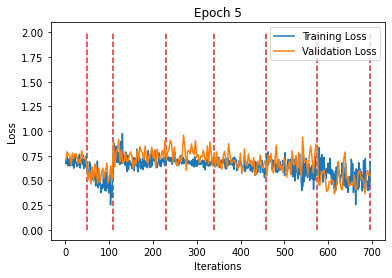

Train



Sequence:1, Seq Training Mean Loss: 0.27858685652414955, Seq Training Acc: 0.22239583333333332
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.23529379057387512, Seq Training Acc: 0.38619791666666664
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.7013597001632055, Seq Training Acc: 0.5458333333333333
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.6332110131780306, Seq Training Acc: 0.49765625
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6371186929444472, Seq Training Acc: 0.6221354166666667
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.5890636478861173, Seq Training Acc: 0.6359375
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.5319700126846632, Seq Training Acc: 0.73515625
******************************************************************
Epoch:6, Epoch Training Loss Mean: 0.6227229237556458, Epoch Acc: 1.2151041666666667
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.7261435016989708, Seq Val Acc: 0.5



******************************************************************
Sequence:2, Seq Mean Loss: 0.5535541594028472, Seq Val Acc: 0.740625



******************************************************************
Sequence:3, Seq Mean Loss: 0.7368768289685249, Seq Val Acc: 0.53359375



******************************************************************
Sequence:4, Seq Mean Loss: 0.7370287663227802, Seq Val Acc: 0.5650337837837838



******************************************************************
Sequence:5, Seq Mean Loss: 0.686361999809742, Seq Val Acc: 0.578125



******************************************************************
Sequence:6, Seq Mean Loss: 0.6362202018499374, Seq Val Acc: 0.6792763157894737



******************************************************************
Sequence:7, Seq Mean Loss: 0.4808426029980183, Seq Val Acc: 0.76328125
Epoch:6, Epoch Val Mean Loss: 0.6506453156471252, Epoch Val Acc: 1.2044270833333333
******************************************************************


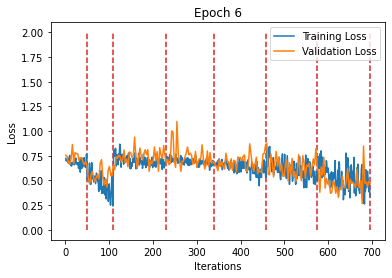

Train



Sequence:1, Seq Training Mean Loss: 0.2804480815927188, Seq Training Acc: 0.22473958333333333
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.23124145021041234, Seq Training Acc: 0.3919270833333333
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.7006872445344925, Seq Training Acc: 0.54375
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.6216715077559153, Seq Training Acc: 0.5177083333333333
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6228621080517769, Seq Training Acc: 0.6434895833333333
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.55614150116841, Seq Training Acc: 0.6776041666666667
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.5343340210616588, Seq Training Acc: 0.7369791666666666
******************************************************************
Epoch:7, Epoch Training Loss Mean: 0.6124982833862305, Epoch Acc: 1.2453993055555554
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.7330165505409241, Seq Val Acc: 0.5234375



******************************************************************
Sequence:2, Seq Mean Loss: 0.5752323523163796, Seq Val Acc: 0.6953125



******************************************************************
Sequence:3, Seq Mean Loss: 0.721365524828434, Seq Val Acc: 0.49921875



******************************************************************
Sequence:4, Seq Mean Loss: 0.7113726735115051, Seq Val Acc: 0.5464527027027027



******************************************************************
Sequence:5, Seq Mean Loss: 0.6527163133025169, Seq Val Acc: 0.6078125



******************************************************************
Sequence:6, Seq Mean Loss: 0.6276734345837643, Seq Val Acc: 0.647203947368421



******************************************************************
Sequence:7, Seq Mean Loss: 0.4701667033135891, Seq Val Acc: 0.775
Epoch:7, Epoch Val Mean Loss: 0.6371222734451294, Epoch Val Acc: 1.1864583333333334
******************************************************************


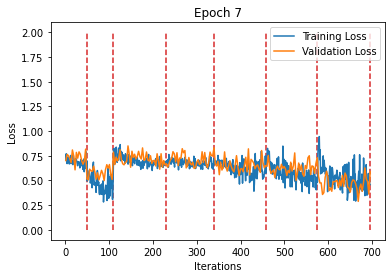

Train



Sequence:1, Seq Training Mean Loss: 0.2840912476181984, Seq Training Acc: 0.22708333333333333
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2220434618492921, Seq Training Acc: 0.39791666666666664
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.690811442832152, Seq Training Acc: 0.5638020833333334
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.6254620254039764, Seq Training Acc: 0.5234375
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.5941016631821792, Seq Training Acc: 0.6859375
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.5128647538522879, Seq Training Acc: 0.7052083333333333
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.5128473331530888, Seq Training Acc: 0.7541666666666667
******************************************************************
Epoch:8, Epoch Training Loss Mean: 0.5943405032157898, Epoch Acc: 1.2858506944444446
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.7712143436074257, Seq Val Acc: 0.4453125



******************************************************************
Sequence:2, Seq Mean Loss: 0.6014074593782425, Seq Val Acc: 0.6578125



******************************************************************
Sequence:3, Seq Mean Loss: 0.735015644133091, Seq Val Acc: 0.4984375



******************************************************************
Sequence:4, Seq Mean Loss: 0.7256077882405874, Seq Val Acc: 0.5701013513513513



******************************************************************
Sequence:5, Seq Mean Loss: 0.6465000934898854, Seq Val Acc: 0.628125



******************************************************************
Sequence:6, Seq Mean Loss: 0.6291039374313856, Seq Val Acc: 0.6554276315789473



******************************************************************
Sequence:7, Seq Mean Loss: 0.4960123963654041, Seq Val Acc: 0.7703125
Epoch:8, Epoch Val Mean Loss: 0.6503123044967651, Epoch Val Acc: 1.1846354166666666
******************************************************************


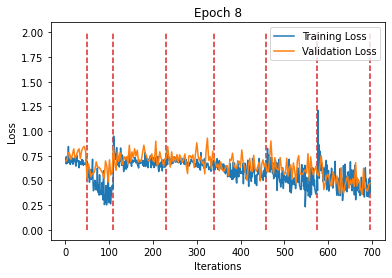

Train



Sequence:1, Seq Training Mean Loss: 0.2846227501829465, Seq Training Acc: 0.22109375
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.20075946611662707, Seq Training Acc: 0.4109375
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.7040477365255355, Seq Training Acc: 0.5473958333333333
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.6073689371347427, Seq Training Acc: 0.5541666666666667
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.5822775172690551, Seq Training Acc: 0.68828125
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.48249229167898494, Seq Training Acc: 0.7330729166666666
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.4997072740147511, Seq Training Acc: 0.7627604166666667
******************************************************************
Epoch:9, Epoch Training Loss Mean: 0.5803642272949219, Epoch Acc: 1.3059027777777779
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.7316745780408382, Seq Val Acc: 0.517578125



******************************************************************
Sequence:2, Seq Mean Loss: 0.5955053359270096, Seq Val Acc: 0.66875



******************************************************************
Sequence:3, Seq Mean Loss: 0.730340126156807, Seq Val Acc: 0.50546875



******************************************************************
Sequence:4, Seq Mean Loss: 0.6868025322218199, Seq Val Acc: 0.5869932432432432



******************************************************************
Sequence:5, Seq Mean Loss: 0.6582644075155258, Seq Val Acc: 0.6078125



******************************************************************
Sequence:6, Seq Mean Loss: 0.6028371539555097, Seq Val Acc: 0.6800986842105263



******************************************************************
Sequence:7, Seq Mean Loss: 0.5111016444861889, Seq Val Acc: 0.74921875
Epoch:9, Epoch Val Mean Loss: 0.6403664350509644, Epoch Val Acc: 1.19765625
******************************************************************


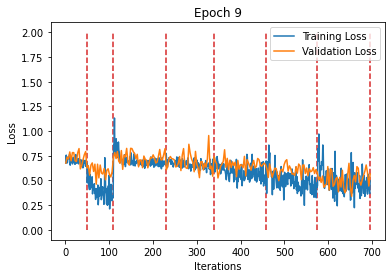

Train



Sequence:1, Seq Training Mean Loss: 0.28834647287925086, Seq Training Acc: 0.20989583333333334
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.22237444296479225, Seq Training Acc: 0.4002604166666667
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.6916509583592415, Seq Training Acc: 0.553125
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.5991529136896133, Seq Training Acc: 0.5677083333333334
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.5692922987043858, Seq Training Acc: 0.7088541666666667
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.460663195947806, Seq Training Acc: 0.7526041666666666
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.47777048448721565, Seq Training Acc: 0.7783854166666667
******************************************************************
Epoch:10, Epoch Training Loss Mean: 0.5713813900947571, Epoch Acc: 1.323611111111111
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.7337499894201756, Seq Val Acc: 0.490234375



******************************************************************
Sequence:2, Seq Mean Loss: 0.5643291249871254, Seq Val Acc: 0.73125



******************************************************************
Sequence:3, Seq Mean Loss: 0.725273211300373, Seq Val Acc: 0.50078125



******************************************************************
Sequence:4, Seq Mean Loss: 0.6910337596326261, Seq Val Acc: 0.5912162162162162



******************************************************************
Sequence:5, Seq Mean Loss: 0.6425847545266151, Seq Val Acc: 0.6359375



******************************************************************
Sequence:6, Seq Mean Loss: 0.6061951243563702, Seq Val Acc: 0.680921052631579



******************************************************************
Sequence:7, Seq Mean Loss: 0.4286784268915653, Seq Val Acc: 0.79765625
Epoch:10, Epoch Val Mean Loss: 0.6211762428283691, Epoch Val Acc: 1.2299479166666667
******************************************************************


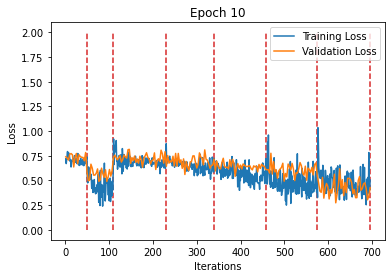

Train



Sequence:1, Seq Training Mean Loss: 0.28509026219447453, Seq Training Acc: 0.21223958333333334
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.21659113032122454, Seq Training Acc: 0.4036458333333333
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.6906727289160093, Seq Training Acc: 0.55546875
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.5870251774787902, Seq Training Acc: 0.5809895833333333
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.5355612086753051, Seq Training Acc: 0.73515625
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.44447655354936916, Seq Training Acc: 0.7609375
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.44779760266343754, Seq Training Acc: 0.78671875
******************************************************************
Epoch:11, Epoch Training Loss Mean: 0.5537636280059814, Epoch Acc: 1.3450520833333333
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.7140938453376293, Seq Val Acc: 0.53515625



******************************************************************
Sequence:2, Seq Mean Loss: 0.5781016513705254, Seq Val Acc: 0.7359375



******************************************************************
Sequence:3, Seq Mean Loss: 0.7270232886075974, Seq Val Acc: 0.484375



******************************************************************
Sequence:4, Seq Mean Loss: 0.676091725761826, Seq Val Acc: 0.5853040540540541



******************************************************************
Sequence:5, Seq Mean Loss: 0.6520099461078643, Seq Val Acc: 0.61015625



******************************************************************
Sequence:6, Seq Mean Loss: 0.6381737621206987, Seq Val Acc: 0.6348684210526315



******************************************************************
Sequence:7, Seq Mean Loss: 0.4147173076868057, Seq Val Acc: 0.82890625
Epoch:11, Epoch Val Mean Loss: 0.6233921051025391, Epoch Val Acc: 1.2166666666666666
******************************************************************


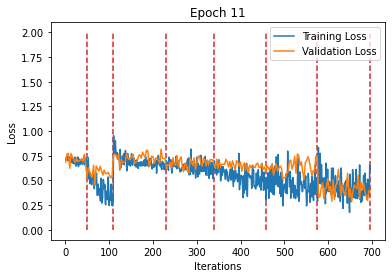

Train



Sequence:1, Seq Training Mean Loss: 0.28470416118701297, Seq Training Acc: 0.2140625
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.19815561150511105, Seq Training Acc: 0.41692708333333334
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.6905884782473246, Seq Training Acc: 0.5565104166666667
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.5847708729406198, Seq Training Acc: 0.5921875
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.5450301883121331, Seq Training Acc: 0.73125
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.426499205827713, Seq Training Acc: 0.7622395833333333
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.44878052435815335, Seq Training Acc: 0.7903645833333334
******************************************************************
Epoch:12, Epoch Training Loss Mean: 0.5488107204437256, Epoch Acc: 1.3545138888888888
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.7261690646409988, Seq Val Acc: 0.458984375



******************************************************************
Sequence:2, Seq Mean Loss: 0.5451446607708931, Seq Val Acc: 0.7359375



******************************************************************
Sequence:3, Seq Mean Loss: 0.7260415554046631, Seq Val Acc: 0.5140625



******************************************************************
Sequence:4, Seq Mean Loss: 0.7057286968102326, Seq Val Acc: 0.5785472972972973



******************************************************************
Sequence:5, Seq Mean Loss: 0.6365579232573509, Seq Val Acc: 0.634375



******************************************************************
Sequence:6, Seq Mean Loss: 0.6278403824881503, Seq Val Acc: 0.6332236842105263



******************************************************************
Sequence:7, Seq Mean Loss: 0.3809639073908329, Seq Val Acc: 0.82890625
Epoch:12, Epoch Val Mean Loss: 0.6157316565513611, Epoch Val Acc: 1.221875
******************************************************************


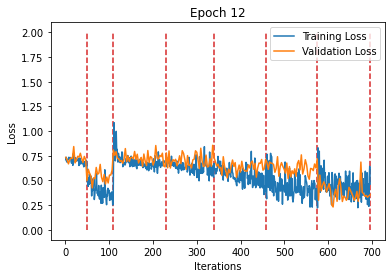

Train



Sequence:1, Seq Training Mean Loss: 0.28392975678046545, Seq Training Acc: 0.2109375
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.21176129256685575, Seq Training Acc: 0.40078125
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.6834245180090268, Seq Training Acc: 0.5734375
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.5759291532138984, Seq Training Acc: 0.60625
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.5304260397950809, Seq Training Acc: 0.7294270833333333
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.40970382690429685, Seq Training Acc: 0.77265625
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.4401881039142609, Seq Training Acc: 0.7950520833333333
******************************************************************
Epoch:13, Epoch Training Loss Mean: 0.5413575768470764, Epoch Acc: 1.3628472222222223
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.7281442955136299, Seq Val Acc: 0.4765625



******************************************************************
Sequence:2, Seq Mean Loss: 0.5516682997345924, Seq Val Acc: 0.709375



******************************************************************
Sequence:3, Seq Mean Loss: 0.7026229962706566, Seq Val Acc: 0.54609375



******************************************************************
Sequence:4, Seq Mean Loss: 0.6789861273121189, Seq Val Acc: 0.6097972972972973



******************************************************************
Sequence:5, Seq Mean Loss: 0.6304183036088944, Seq Val Acc: 0.65390625



******************************************************************
Sequence:6, Seq Mean Loss: 0.6090624599080336, Seq Val Acc: 0.6595394736842105



******************************************************************
Sequence:7, Seq Mean Loss: 0.4154060479253531, Seq Val Acc: 0.80390625
Epoch:13, Epoch Val Mean Loss: 0.6099066138267517, Epoch Val Acc: 1.2466145833333333
******************************************************************


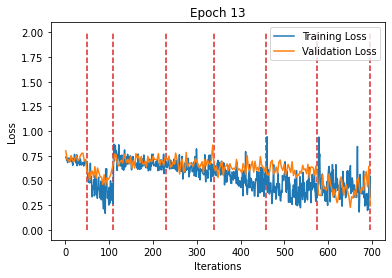

Train



Sequence:1, Seq Training Mean Loss: 0.28179601778586705, Seq Training Acc: 0.22239583333333332
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.1895183052867651, Seq Training Acc: 0.41432291666666665
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.6777024333675702, Seq Training Acc: 0.5877604166666667
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.5684982265035311, Seq Training Acc: 0.6143229166666667
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.5237808495759964, Seq Training Acc: 0.7497395833333333
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.42442854344844816, Seq Training Acc: 0.7736979166666667
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.4092335513482491, Seq Training Acc: 0.8080729166666667
******************************************************************
Epoch:14, Epoch Training Loss Mean: 0.5309279561042786, Epoch Acc: 1.3901041666666667
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.7063231989741325, Seq Val Acc: 0.494140625



******************************************************************
Sequence:2, Seq Mean Loss: 0.5295119881629944, Seq Val Acc: 0.7359375



******************************************************************
Sequence:3, Seq Mean Loss: 0.7082648873329163, Seq Val Acc: 0.54453125



******************************************************************
Sequence:4, Seq Mean Loss: 0.6397915095896334, Seq Val Acc: 0.6444256756756757



******************************************************************
Sequence:5, Seq Mean Loss: 0.6169889137148857, Seq Val Acc: 0.66875



******************************************************************
Sequence:6, Seq Mean Loss: 0.6068176415405775, Seq Val Acc: 0.6751644736842105



******************************************************************
Sequence:7, Seq Mean Loss: 0.37835550829768183, Seq Val Acc: 0.828125
Epoch:14, Epoch Val Mean Loss: 0.5920655131340027, Epoch Val Acc: 1.2815104166666667
******************************************************************


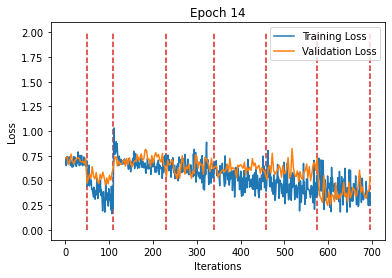

Train



Sequence:1, Seq Training Mean Loss: 0.2799197306235631, Seq Training Acc: 0.22604166666666667
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.19311485340197881, Seq Training Acc: 0.4153645833333333
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.6663940399885178, Seq Training Acc: 0.6096354166666667
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.5572815552353859, Seq Training Acc: 0.61875
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.4994578003883362, Seq Training Acc: 0.759375
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.4235998038202524, Seq Training Acc: 0.76953125
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.41480472063024837, Seq Training Acc: 0.8072916666666666
******************************************************************
Epoch:15, Epoch Training Loss Mean: 0.5239549279212952, Epoch Acc: 1.4019965277777777
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.704461932182312, Seq Val Acc: 0.53515625



******************************************************************
Sequence:2, Seq Mean Loss: 0.5379060983657837, Seq Val Acc: 0.7578125



******************************************************************
Sequence:3, Seq Mean Loss: 0.6936938837170601, Seq Val Acc: 0.553125



******************************************************************
Sequence:4, Seq Mean Loss: 0.6477941693486394, Seq Val Acc: 0.6309121621621622



******************************************************************
Sequence:5, Seq Mean Loss: 0.629405339807272, Seq Val Acc: 0.63984375



******************************************************************
Sequence:6, Seq Mean Loss: 0.5667064433035097, Seq Val Acc: 0.7171052631578947



******************************************************************
Sequence:7, Seq Mean Loss: 0.40662963688373566, Seq Val Acc: 0.8296875
Epoch:15, Epoch Val Mean Loss: 0.5918696522712708, Epoch Val Acc: 1.2934895833333333
******************************************************************


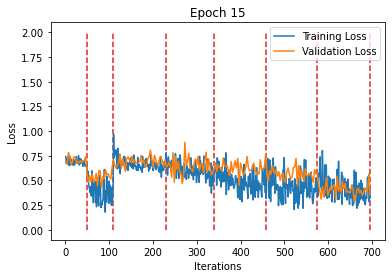

Train



Sequence:1, Seq Training Mean Loss: 0.27527182747920353, Seq Training Acc: 0.2359375
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.19451137458284695, Seq Training Acc: 0.41041666666666665
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.6605782394607862, Seq Training Acc: 0.6106770833333334
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.5381211963792641, Seq Training Acc: 0.6328125
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.4834598834315936, Seq Training Acc: 0.7778645833333333
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.39396189066270987, Seq Training Acc: 0.784375
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.4101258604476849, Seq Training Acc: 0.8098958333333334
******************************************************************
Epoch:16, Epoch Training Loss Mean: 0.5103937387466431, Epoch Acc: 1.4206597222222221
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.7038385532796383, Seq Val Acc: 0.544921875



******************************************************************
Sequence:2, Seq Mean Loss: 0.5526322245597839, Seq Val Acc: 0.725



******************************************************************
Sequence:3, Seq Mean Loss: 0.6990203753113746, Seq Val Acc: 0.540625



******************************************************************
Sequence:4, Seq Mean Loss: 0.6659838621680801, Seq Val Acc: 0.6478040540540541



******************************************************************
Sequence:5, Seq Mean Loss: 0.6030000314116478, Seq Val Acc: 0.68515625



******************************************************************
Sequence:6, Seq Mean Loss: 0.5944415817135259, Seq Val Acc: 0.6735197368421053



******************************************************************
Sequence:7, Seq Mean Loss: 0.36934622600674627, Seq Val Acc: 0.85
Epoch:16, Epoch Val Mean Loss: 0.5904714465141296, Epoch Val Acc: 1.2984375
******************************************************************


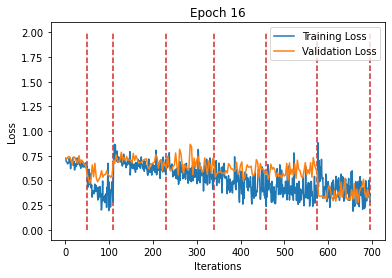

Train



Sequence:1, Seq Training Mean Loss: 0.2753233244021734, Seq Training Acc: 0.23828125
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.1954226194570462, Seq Training Acc: 0.41067708333333336
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.6626601229111354, Seq Training Acc: 0.6041666666666666
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.5376701856652896, Seq Training Acc: 0.6427083333333333
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.49314303720990815, Seq Training Acc: 0.7734375
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.39780111784736316, Seq Training Acc: 0.7872395833333333
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.3700287130350868, Seq Training Acc: 0.8356770833333333
******************************************************************
Epoch:17, Epoch Training Loss Mean: 0.5062530636787415, Epoch Acc: 1.4307291666666666
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.7038593925535679, Seq Val Acc: 0.544921875



******************************************************************
Sequence:2, Seq Mean Loss: 0.5647050410509109, Seq Val Acc: 0.7140625



******************************************************************
Sequence:3, Seq Mean Loss: 0.6923633933067321, Seq Val Acc: 0.5546875



******************************************************************
Sequence:4, Seq Mean Loss: 0.6423239595181233, Seq Val Acc: 0.6326013513513513



******************************************************************
Sequence:5, Seq Mean Loss: 0.6173010416328907, Seq Val Acc: 0.66015625



******************************************************************
Sequence:6, Seq Mean Loss: 0.5722841330264744, Seq Val Acc: 0.7220394736842105



******************************************************************
Sequence:7, Seq Mean Loss: 0.4181025929749012, Seq Val Acc: 0.81484375
Epoch:17, Epoch Val Mean Loss: 0.5938498973846436, Epoch Val Acc: 1.2919270833333334
******************************************************************


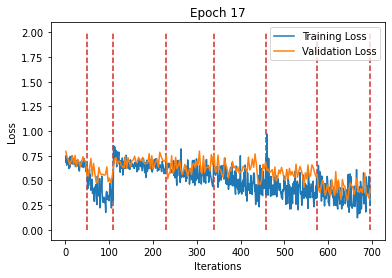

Train



Sequence:1, Seq Training Mean Loss: 0.2677065158883731, Seq Training Acc: 0.2557291666666667
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.19531498154004415, Seq Training Acc: 0.40703125
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.6481913313269615, Seq Training Acc: 0.6255208333333333
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.5330263699094454, Seq Training Acc: 0.6356770833333333
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.49321900109450023, Seq Training Acc: 0.76875
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.4024653237313032, Seq Training Acc: 0.78125
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.3863562813649575, Seq Training Acc: 0.8328125
******************************************************************
Epoch:18, Epoch Training Loss Mean: 0.5052569508552551, Epoch Acc: 1.4355902777777778
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.6915356367826462, Seq Val Acc: 0.591796875



******************************************************************
Sequence:2, Seq Mean Loss: 0.5376938045024872, Seq Val Acc: 0.75



******************************************************************
Sequence:3, Seq Mean Loss: 0.6874227225780487, Seq Val Acc: 0.5625



******************************************************************
Sequence:4, Seq Mean Loss: 0.6391497737652546, Seq Val Acc: 0.6528716216216216



******************************************************************
Sequence:5, Seq Mean Loss: 0.598000155389309, Seq Val Acc: 0.70234375



******************************************************************
Sequence:6, Seq Mean Loss: 0.5631368089663354, Seq Val Acc: 0.7236842105263158



******************************************************************
Sequence:7, Seq Mean Loss: 0.3427727486938238, Seq Val Acc: 0.85390625
Epoch:18, Epoch Val Mean Loss: 0.5714026689529419, Epoch Val Acc: 1.340625
******************************************************************


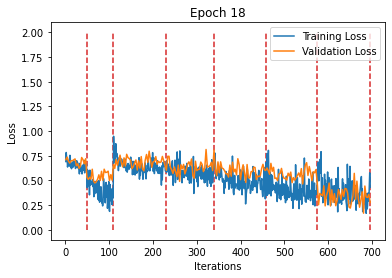

Train



Sequence:1, Seq Training Mean Loss: 0.26096427589654925, Seq Training Acc: 0.265625
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.19520297174652418, Seq Training Acc: 0.41067708333333336
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.650910098850727, Seq Training Acc: 0.6247395833333333
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.5226017624139786, Seq Training Acc: 0.6401041666666667
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.4887891585628192, Seq Training Acc: 0.7731770833333333
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.37667589969933035, Seq Training Acc: 0.80078125
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.3834082545091709, Seq Training Acc: 0.8291666666666667
******************************************************************
Epoch:19, Epoch Training Loss Mean: 0.49701622128486633, Epoch Acc: 1.4480902777777778
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.6730811558663845, Seq Val Acc: 0.57421875



******************************************************************
Sequence:2, Seq Mean Loss: 0.5411158442497254, Seq Val Acc: 0.7703125



******************************************************************
Sequence:3, Seq Mean Loss: 0.689395523071289, Seq Val Acc: 0.55625



******************************************************************
Sequence:4, Seq Mean Loss: 0.6474796243616052, Seq Val Acc: 0.660472972972973



******************************************************************
Sequence:5, Seq Mean Loss: 0.6023594461381435, Seq Val Acc: 0.68046875



******************************************************************
Sequence:6, Seq Mean Loss: 0.5871390018023943, Seq Val Acc: 0.6932565789473685



******************************************************************
Sequence:7, Seq Mean Loss: 0.38250558599829676, Seq Val Acc: 0.8359375
Epoch:19, Epoch Val Mean Loss: 0.5836799740791321, Epoch Val Acc: 1.3190104166666667
******************************************************************


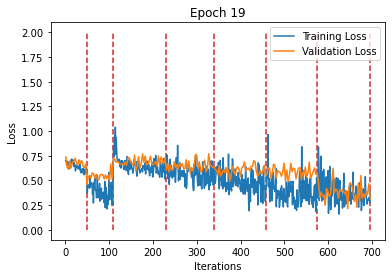

Train



Sequence:1, Seq Training Mean Loss: 0.2605433205763499, Seq Training Acc: 0.26953125
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.18764614549775918, Seq Training Acc: 0.41848958333333336
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.64187224706014, Seq Training Acc: 0.6330729166666667
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.505409670372804, Seq Training Acc: 0.66171875
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.4586116373538971, Seq Training Acc: 0.7903645833333334
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.3732044922808806, Seq Training Acc: 0.8065104166666667
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.3603804203371207, Seq Training Acc: 0.8341145833333333
******************************************************************
Epoch:20, Epoch Training Loss Mean: 0.4813239574432373, Epoch Acc: 1.4712673611111111
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.6742063499987125, Seq Val Acc: 0.59765625



******************************************************************
Sequence:2, Seq Mean Loss: 0.5430105403065681, Seq Val Acc: 0.7296875



******************************************************************
Sequence:3, Seq Mean Loss: 0.7025926053524018, Seq Val Acc: 0.54765625



******************************************************************
Sequence:4, Seq Mean Loss: 0.6454705612079518, Seq Val Acc: 0.6427364864864865



******************************************************************
Sequence:5, Seq Mean Loss: 0.5937028981745243, Seq Val Acc: 0.68828125



******************************************************************
Sequence:6, Seq Mean Loss: 0.5920780301094055, Seq Val Acc: 0.6883223684210527



******************************************************************
Sequence:7, Seq Mean Loss: 0.36915364153683183, Seq Val Acc: 0.82890625
Epoch:20, Epoch Val Mean Loss: 0.582886815071106, Epoch Val Acc: 1.3057291666666666
******************************************************************


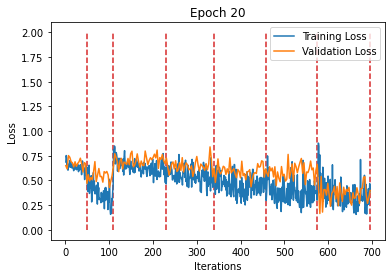

Train



Sequence:1, Seq Training Mean Loss: 0.2500695357720057, Seq Training Acc: 0.27317708333333335
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.1800133615732193, Seq Training Acc: 0.4158854166666667
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.6274055441220602, Seq Training Acc: 0.6526041666666667
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.5028396807610989, Seq Training Acc: 0.6578125
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.47788793841997784, Seq Training Acc: 0.7776041666666667
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.3874684979518255, Seq Training Acc: 0.7864583333333334
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.3646956225236257, Seq Training Acc: 0.8341145833333333
******************************************************************
Epoch:21, Epoch Training Loss Mean: 0.48179224133491516, Epoch Acc: 1.4658854166666666
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.6613628640770912, Seq Val Acc: 0.58984375



******************************************************************
Sequence:2, Seq Mean Loss: 0.5531539335846901, Seq Val Acc: 0.7296875



******************************************************************
Sequence:3, Seq Mean Loss: 0.6927191719412804, Seq Val Acc: 0.56640625



******************************************************************
Sequence:4, Seq Mean Loss: 0.6572271182730391, Seq Val Acc: 0.6638513513513513



******************************************************************
Sequence:5, Seq Mean Loss: 0.553354375809431, Seq Val Acc: 0.72265625



******************************************************************
Sequence:6, Seq Mean Loss: 0.552877813577652, Seq Val Acc: 0.7154605263157895



******************************************************************
Sequence:7, Seq Mean Loss: 0.3599789280444384, Seq Val Acc: 0.84375
Epoch:21, Epoch Val Mean Loss: 0.5680248737335205, Epoch Val Acc: 1.3424479166666667
******************************************************************


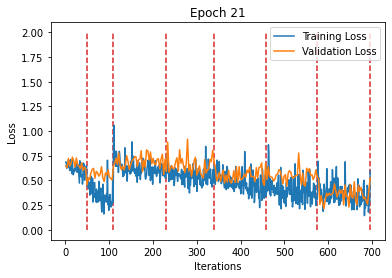

Train



Sequence:1, Seq Training Mean Loss: 0.23749513601263364, Seq Training Acc: 0.28854166666666664
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.18718846514821053, Seq Training Acc: 0.41328125
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.6124522472421329, Seq Training Acc: 0.6640625
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.4940958902239799, Seq Training Acc: 0.6705729166666666
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.45566316569844884, Seq Training Acc: 0.7856770833333333
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.37151633265117806, Seq Training Acc: 0.79765625
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.34750633276999, Seq Training Acc: 0.84609375
******************************************************************
Epoch:22, Epoch Training Loss Mean: 0.4672088027000427, Epoch Acc: 1.4886284722222223
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.6207826733589172, Seq Val Acc: 0.669921875



******************************************************************
Sequence:2, Seq Mean Loss: 0.5326910689473152, Seq Val Acc: 0.7609375



******************************************************************
Sequence:3, Seq Mean Loss: 0.6797550186514855, Seq Val Acc: 0.5734375



******************************************************************
Sequence:4, Seq Mean Loss: 0.6343397820318067, Seq Val Acc: 0.6646959459459459



******************************************************************
Sequence:5, Seq Mean Loss: 0.5773252516984939, Seq Val Acc: 0.6953125



******************************************************************
Sequence:6, Seq Mean Loss: 0.5504464679642728, Seq Val Acc: 0.7138157894736842



******************************************************************
Sequence:7, Seq Mean Loss: 0.4144598595798016, Seq Val Acc: 0.8078125
Epoch:22, Epoch Val Mean Loss: 0.570716381072998, Epoch Val Acc: 1.3393229166666667
******************************************************************


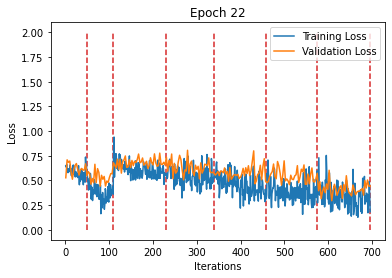

Train



Sequence:1, Seq Training Mean Loss: 0.22354115719596546, Seq Training Acc: 0.29765625
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.17179948426783084, Seq Training Acc: 0.41875
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.6122736764450868, Seq Training Acc: 0.6739583333333333
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.4816308821241061, Seq Training Acc: 0.6734375
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.46865418752034504, Seq Training Acc: 0.7796875
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.3540286177148422, Seq Training Acc: 0.8059895833333334
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.3455679868658384, Seq Training Acc: 0.8427083333333333
******************************************************************
Epoch:23, Epoch Training Loss Mean: 0.4588482677936554, Epoch Acc: 1.4973958333333333
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.6270130015909672, Seq Val Acc: 0.6640625



******************************************************************
Sequence:2, Seq Mean Loss: 0.5164547190070152, Seq Val Acc: 0.7546875



******************************************************************
Sequence:3, Seq Mean Loss: 0.7238295003771782, Seq Val Acc: 0.540625



******************************************************************
Sequence:4, Seq Mean Loss: 0.6759187788576693, Seq Val Acc: 0.6554054054054054



******************************************************************
Sequence:5, Seq Mean Loss: 0.6157946407794952, Seq Val Acc: 0.6765625



******************************************************************
Sequence:6, Seq Mean Loss: 0.5210308071814085, Seq Val Acc: 0.7508223684210527



******************************************************************
Sequence:7, Seq Mean Loss: 0.3110065806657076, Seq Val Acc: 0.86328125
Epoch:23, Epoch Val Mean Loss: 0.5679424405097961, Epoch Val Acc: 1.34765625
******************************************************************


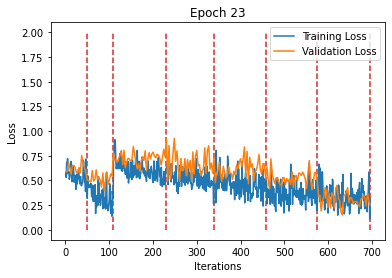

Train



Sequence:1, Seq Training Mean Loss: 0.2169354225198428, Seq Training Acc: 0.3072916666666667
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.17182972157994905, Seq Training Acc: 0.42135416666666664
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.5881946635742982, Seq Training Acc: 0.6885416666666667
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.4879403275748094, Seq Training Acc: 0.6666666666666666
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.46721833596626916, Seq Training Acc: 0.78515625
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.358818011606733, Seq Training Acc: 0.80546875
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.3369835384810964, Seq Training Acc: 0.8513020833333333
******************************************************************
Epoch:24, Epoch Training Loss Mean: 0.45374158024787903, Epoch Acc: 1.50859375
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.5815458875149488, Seq Val Acc: 0.71875



******************************************************************
Sequence:2, Seq Mean Loss: 0.5269340381026268, Seq Val Acc: 0.7671875



******************************************************************
Sequence:3, Seq Mean Loss: 0.6980536058545113, Seq Val Acc: 0.56796875



******************************************************************
Sequence:4, Seq Mean Loss: 0.619548499584198, Seq Val Acc: 0.674831081081081



******************************************************************
Sequence:5, Seq Mean Loss: 0.5450312741100788, Seq Val Acc: 0.740625



******************************************************************
Sequence:6, Seq Mean Loss: 0.5694542401715329, Seq Val Acc: 0.696546052631579



******************************************************************
Sequence:7, Seq Mean Loss: 0.36618577018380166, Seq Val Acc: 0.84296875
Epoch:24, Epoch Val Mean Loss: 0.5574753284454346, Epoch Val Acc: 1.36953125
******************************************************************


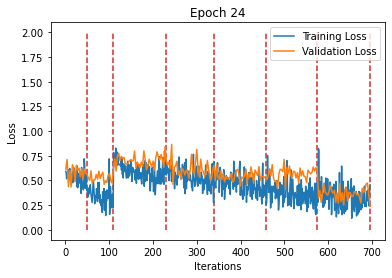

Train



Sequence:1, Seq Training Mean Loss: 0.20566768124699591, Seq Training Acc: 0.31171875
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.16959218643605709, Seq Training Acc: 0.4278645833333333
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.586572157094876, Seq Training Acc: 0.6953125
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.47497727647423743, Seq Training Acc: 0.6783854166666666
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.45981867189208664, Seq Training Acc: 0.78125
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.3539321832358837, Seq Training Acc: 0.809375
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.3474963786701361, Seq Training Acc: 0.84921875
******************************************************************
Epoch:25, Epoch Training Loss Mean: 0.44858530163764954, Epoch Acc: 1.5177083333333334
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.5560705978423357, Seq Val Acc: 0.748046875



******************************************************************
Sequence:2, Seq Mean Loss: 0.542005306482315, Seq Val Acc: 0.740625



******************************************************************
Sequence:3, Seq Mean Loss: 0.6983689203858375, Seq Val Acc: 0.578125



******************************************************************
Sequence:4, Seq Mean Loss: 0.6462713657198725, Seq Val Acc: 0.6984797297297297



******************************************************************
Sequence:5, Seq Mean Loss: 0.5425824798643589, Seq Val Acc: 0.7390625



******************************************************************
Sequence:6, Seq Mean Loss: 0.5649954057053516, Seq Val Acc: 0.7162828947368421



******************************************************************
Sequence:7, Seq Mean Loss: 0.3406349692493677, Seq Val Acc: 0.84921875
Epoch:25, Epoch Val Mean Loss: 0.5557686686515808, Epoch Val Acc: 1.3875
******************************************************************


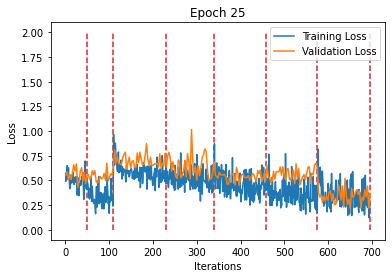

Train



Sequence:1, Seq Training Mean Loss: 0.19600366031130154, Seq Training Acc: 0.31692708333333336
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.17361994112531345, Seq Training Acc: 0.42291666666666666
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.5881568672756354, Seq Training Acc: 0.6833333333333333
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.47033091709017755, Seq Training Acc: 0.68671875
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.43565965021649994, Seq Training Acc: 0.8026041666666667
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.3730042852461338, Seq Training Acc: 0.7953125
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.3354119939729571, Seq Training Acc: 0.846875
******************************************************************
Epoch:26, Epoch Training Loss Mean: 0.4441186785697937, Epoch Acc: 1.5182291666666667
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.5722312927246094, Seq Val Acc: 0.705078125



******************************************************************
Sequence:2, Seq Mean Loss: 0.5475840002298356, Seq Val Acc: 0.7515625



******************************************************************
Sequence:3, Seq Mean Loss: 0.6958268448710442, Seq Val Acc: 0.57421875



******************************************************************
Sequence:4, Seq Mean Loss: 0.6468838501620937, Seq Val Acc: 0.6663851351351351



******************************************************************
Sequence:5, Seq Mean Loss: 0.5626679167151452, Seq Val Acc: 0.71640625



******************************************************************
Sequence:6, Seq Mean Loss: 0.5339812714802591, Seq Val Acc: 0.7368421052631579



******************************************************************
Sequence:7, Seq Mean Loss: 0.35907653979957105, Seq Val Acc: 0.8453125
Epoch:26, Epoch Val Mean Loss: 0.5585983991622925, Epoch Val Acc: 1.3700520833333334
******************************************************************


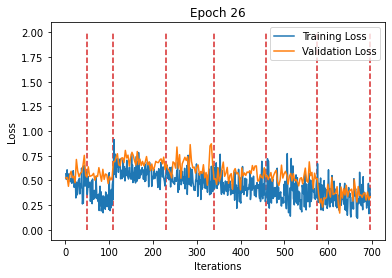

Train



Sequence:1, Seq Training Mean Loss: 0.1991436205804348, Seq Training Acc: 0.31484375
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.1621997807174921, Seq Training Acc: 0.4309895833333333
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.5586641517778238, Seq Training Acc: 0.7114583333333333
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.4588221997022629, Seq Training Acc: 0.6796875
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.4291487021992604, Seq Training Acc: 0.8046875
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.3346261120090882, Seq Training Acc: 0.8111979166666666
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.2959637936825554, Seq Training Acc: 0.8645833333333334
******************************************************************
Epoch:27, Epoch Training Loss Mean: 0.42104777693748474, Epoch Acc: 1.5391493055555556
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.5126755181699991, Seq Val Acc: 0.76953125



******************************************************************
Sequence:2, Seq Mean Loss: 0.518015156686306, Seq Val Acc: 0.7640625



******************************************************************
Sequence:3, Seq Mean Loss: 0.687725342810154, Seq Val Acc: 0.596875



******************************************************************
Sequence:4, Seq Mean Loss: 0.6869517371461198, Seq Val Acc: 0.6545608108108109



******************************************************************
Sequence:5, Seq Mean Loss: 0.5447346940636635, Seq Val Acc: 0.73515625



******************************************************************
Sequence:6, Seq Mean Loss: 0.5177910641620034, Seq Val Acc: 0.7639802631578947



******************************************************************
Sequence:7, Seq Mean Loss: 0.31861841343343256, Seq Val Acc: 0.8609375
Epoch:27, Epoch Val Mean Loss: 0.5441538095474243, Epoch Val Acc: 1.4046875
******************************************************************


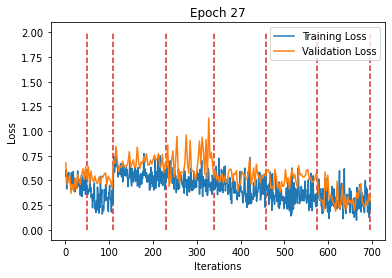

Train



Sequence:1, Seq Training Mean Loss: 0.2001911016801993, Seq Training Acc: 0.3177083333333333
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.17066502757370472, Seq Training Acc: 0.42604166666666665
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.5604116596281529, Seq Training Acc: 0.70234375
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.4499284212787946, Seq Training Acc: 0.6921875
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.4143582221120596, Seq Training Acc: 0.8135416666666667
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.36454467015961806, Seq Training Acc: 0.7981770833333334
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.3112690001105269, Seq Training Acc: 0.8692708333333333
******************************************************************
Epoch:28, Epoch Training Loss Mean: 0.4267110526561737, Epoch Acc: 1.5397569444444446
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.5227170120924711, Seq Val Acc: 0.755859375



******************************************************************
Sequence:2, Seq Mean Loss: 0.5188324853777886, Seq Val Acc: 0.7890625



******************************************************************
Sequence:3, Seq Mean Loss: 0.6647829994559288, Seq Val Acc: 0.6125



******************************************************************
Sequence:4, Seq Mean Loss: 0.6376937571409587, Seq Val Acc: 0.6790540540540541



******************************************************************
Sequence:5, Seq Mean Loss: 0.5265932835638523, Seq Val Acc: 0.74453125



******************************************************************
Sequence:6, Seq Mean Loss: 0.5342481904908231, Seq Val Acc: 0.7615131578947368



******************************************************************
Sequence:7, Seq Mean Loss: 0.3585351433604956, Seq Val Acc: 0.8265625
Epoch:28, Epoch Val Mean Loss: 0.539535403251648, Epoch Val Acc: 1.4106770833333333
******************************************************************


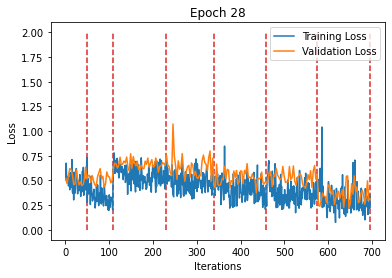

Train



Sequence:1, Seq Training Mean Loss: 0.18774501904845237, Seq Training Acc: 0.31875
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.1660822165509065, Seq Training Acc: 0.4270833333333333
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.5344021568695704, Seq Training Acc: 0.72890625
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.43749179417888323, Seq Training Acc: 0.6981770833333333
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.4039682513723771, Seq Training Acc: 0.8135416666666667
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.3422833583007256, Seq Training Acc: 0.8083333333333333
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.3012177647401889, Seq Training Acc: 0.8658854166666666
******************************************************************
Epoch:29, Epoch Training Loss Mean: 0.4097595512866974, Epoch Acc: 1.5535590277777778
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.5507627334445715, Seq Val Acc: 0.7578125



******************************************************************
Sequence:2, Seq Mean Loss: 0.5328696966171265, Seq Val Acc: 0.7390625



******************************************************************
Sequence:3, Seq Mean Loss: 0.7099083155393601, Seq Val Acc: 0.58046875



******************************************************************
Sequence:4, Seq Mean Loss: 0.6910852266324533, Seq Val Acc: 0.6798986486486487



******************************************************************
Sequence:5, Seq Mean Loss: 0.5456056110560894, Seq Val Acc: 0.734375



******************************************************************
Sequence:6, Seq Mean Loss: 0.5462560057640076, Seq Val Acc: 0.7319078947368421



******************************************************************
Sequence:7, Seq Mean Loss: 0.34778716377913954, Seq Val Acc: 0.8515625
Epoch:29, Epoch Val Mean Loss: 0.5624655485153198, Epoch Val Acc: 1.3877604166666666
******************************************************************


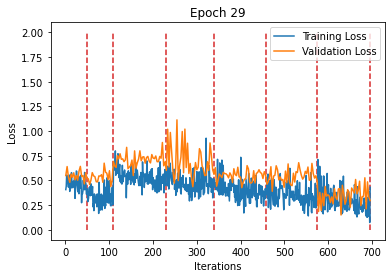

Train



Sequence:1, Seq Training Mean Loss: 0.1808718264102936, Seq Training Acc: 0.32317708333333334
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.16429325876136622, Seq Training Acc: 0.4265625
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.5479535815616449, Seq Training Acc: 0.7153645833333333
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.45121753414471943, Seq Training Acc: 0.6838541666666667
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.4222603121151527, Seq Training Acc: 0.8049479166666667
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.35309096549948055, Seq Training Acc: 0.8114583333333333
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.30413841058810553, Seq Training Acc: 0.86484375
******************************************************************
Epoch:30, Epoch Training Loss Mean: 0.4185023009777069, Epoch Acc: 1.5434027777777777
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.49013273417949677, Seq Val Acc: 0.80078125



******************************************************************
Sequence:2, Seq Mean Loss: 0.5314018711447716, Seq Val Acc: 0.76875



******************************************************************
Sequence:3, Seq Mean Loss: 0.6526322096586228, Seq Val Acc: 0.63046875



******************************************************************
Sequence:4, Seq Mean Loss: 0.6344494094719758, Seq Val Acc: 0.6587837837837838



******************************************************************
Sequence:5, Seq Mean Loss: 0.5375936776399612, Seq Val Acc: 0.74765625



******************************************************************
Sequence:6, Seq Mean Loss: 0.5289681247974697, Seq Val Acc: 0.7327302631578947



******************************************************************
Sequence:7, Seq Mean Loss: 0.3331932835280895, Seq Val Acc: 0.853125
Epoch:30, Epoch Val Mean Loss: 0.5323911309242249, Epoch Val Acc: 1.4138020833333333
******************************************************************


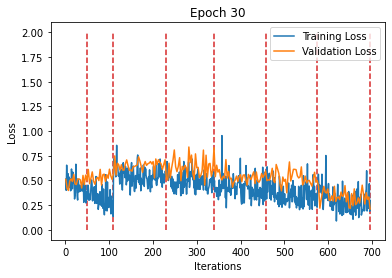

Train



Sequence:1, Seq Training Mean Loss: 0.1689787487188975, Seq Training Acc: 0.3359375
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.16709911103049915, Seq Training Acc: 0.4244791666666667
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.5131609914203484, Seq Training Acc: 0.7513020833333334
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.44216012507677077, Seq Training Acc: 0.6903645833333333
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.4160165761907895, Seq Training Acc: 0.80625
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.3283990395565828, Seq Training Acc: 0.82109375
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.29187747233857714, Seq Training Acc: 0.8705729166666667
******************************************************************
Epoch:31, Epoch Training Loss Mean: 0.4019036889076233, Epoch Acc: 1.5666666666666667
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.46985503286123276, Seq Val Acc: 0.779296875



******************************************************************
Sequence:2, Seq Mean Loss: 0.4860092535614967, Seq Val Acc: 0.7859375



******************************************************************
Sequence:3, Seq Mean Loss: 0.6983889028429985, Seq Val Acc: 0.5609375



******************************************************************
Sequence:4, Seq Mean Loss: 0.6534542763555372, Seq Val Acc: 0.6739864864864865



******************************************************************
Sequence:5, Seq Mean Loss: 0.5144706897437572, Seq Val Acc: 0.7609375



******************************************************************
Sequence:6, Seq Mean Loss: 0.5377392588477385, Seq Val Acc: 0.7351973684210527



******************************************************************
Sequence:7, Seq Mean Loss: 0.36741122901439666, Seq Val Acc: 0.8328125
Epoch:31, Epoch Val Mean Loss: 0.5413878560066223, Epoch Val Acc: 1.39375
******************************************************************


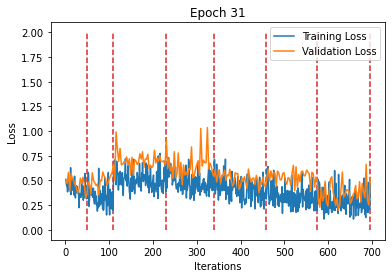

Train



Sequence:1, Seq Training Mean Loss: 0.1736994653940201, Seq Training Acc: 0.33307291666666666
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.1523230920235316, Seq Training Acc: 0.43645833333333334
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.5078843501706918, Seq Training Acc: 0.74375
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.4295457065105438, Seq Training Acc: 0.7033854166666667
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.4153038733949264, Seq Training Acc: 0.8057291666666667
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.34272784801820916, Seq Training Acc: 0.8111979166666666
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.2870309619853894, Seq Training Acc: 0.8739583333333333
******************************************************************
Epoch:32, Epoch Training Loss Mean: 0.39859259128570557, Epoch Acc: 1.5691840277777778
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.4595696274191141, Seq Val Acc: 0.775390625



******************************************************************
Sequence:2, Seq Mean Loss: 0.5421667084097862, Seq Val Acc: 0.7515625



******************************************************************
Sequence:3, Seq Mean Loss: 0.6172154083847999, Seq Val Acc: 0.66875



******************************************************************
Sequence:4, Seq Mean Loss: 0.5557490732218768, Seq Val Acc: 0.7238175675675675



******************************************************************
Sequence:5, Seq Mean Loss: 0.5257193192839622, Seq Val Acc: 0.74921875



******************************************************************
Sequence:6, Seq Mean Loss: 0.5299982750102094, Seq Val Acc: 0.7467105263157895



******************************************************************
Sequence:7, Seq Mean Loss: 0.3002689894288778, Seq Val Acc: 0.88515625
Epoch:32, Epoch Val Mean Loss: 0.5048798322677612, Epoch Val Acc: 1.4559895833333334
******************************************************************


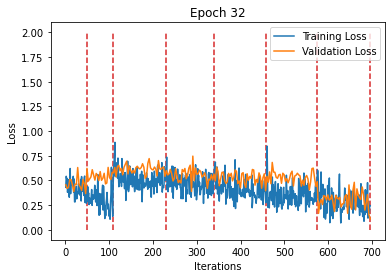

Train



Sequence:1, Seq Training Mean Loss: 0.16525039648016293, Seq Training Acc: 0.33255208333333336
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.16305495065947373, Seq Training Acc: 0.43072916666666666
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.49008101721604663, Seq Training Acc: 0.7627604166666667
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.42700393485526245, Seq Training Acc: 0.7057291666666666
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.41672460349897544, Seq Training Acc: 0.8106770833333333
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.3447820346802473, Seq Training Acc: 0.809375
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.2859006014962991, Seq Training Acc: 0.8778645833333333
******************************************************************
Epoch:33, Epoch Training Loss Mean: 0.39587873220443726, Epoch Acc: 1.5765625
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.46755762211978436, Seq Val Acc: 0.806640625



******************************************************************
Sequence:2, Seq Mean Loss: 0.5164191439747811, Seq Val Acc: 0.7578125



******************************************************************
Sequence:3, Seq Mean Loss: 0.6935133844614029, Seq Val Acc: 0.6140625



******************************************************************
Sequence:4, Seq Mean Loss: 0.6035399678591136, Seq Val Acc: 0.7035472972972973



******************************************************************
Sequence:5, Seq Mean Loss: 0.5384552285075188, Seq Val Acc: 0.72734375



******************************************************************
Sequence:6, Seq Mean Loss: 0.507007257718789, Seq Val Acc: 0.7639802631578947



******************************************************************
Sequence:7, Seq Mean Loss: 0.3049648176878691, Seq Val Acc: 0.87109375
Epoch:33, Epoch Val Mean Loss: 0.5233069658279419, Epoch Val Acc: 1.4302083333333333
******************************************************************


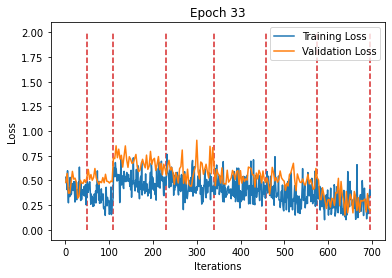

Train



Sequence:1, Seq Training Mean Loss: 0.16303071305155753, Seq Training Acc: 0.3328125
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.15844285363952318, Seq Training Acc: 0.43203125
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.49967104742924373, Seq Training Acc: 0.76015625
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.4211963246266047, Seq Training Acc: 0.703125
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.4033996866395076, Seq Training Acc: 0.8169270833333333
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.33299302620192367, Seq Training Acc: 0.8153645833333333
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.2908214752251903, Seq Training Acc: 0.8734375
******************************************************************
Epoch:34, Epoch Training Loss Mean: 0.39186564087867737, Epoch Acc: 1.577951388888889
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.45045310631394386, Seq Val Acc: 0.79296875



******************************************************************
Sequence:2, Seq Mean Loss: 0.5282824024558067, Seq Val Acc: 0.74375



******************************************************************
Sequence:3, Seq Mean Loss: 0.6647210359573364, Seq Val Acc: 0.61796875



******************************************************************
Sequence:4, Seq Mean Loss: 0.5904374315931991, Seq Val Acc: 0.7179054054054054



******************************************************************
Sequence:5, Seq Mean Loss: 0.5089467570185662, Seq Val Acc: 0.753125



******************************************************************
Sequence:6, Seq Mean Loss: 0.48735346213767405, Seq Val Acc: 0.7754934210526315



******************************************************************
Sequence:7, Seq Mean Loss: 0.29354463182389734, Seq Val Acc: 0.87734375
Epoch:34, Epoch Val Mean Loss: 0.5057446956634521, Epoch Val Acc: 1.44609375
******************************************************************


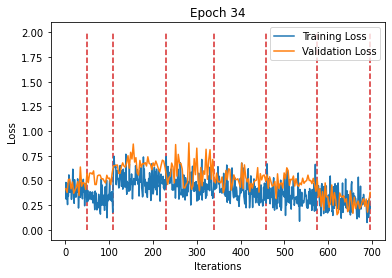

Train



Sequence:1, Seq Training Mean Loss: 0.169410719225804, Seq Training Acc: 0.33125
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.15894302241504193, Seq Training Acc: 0.4244791666666667
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.49374649251500763, Seq Training Acc: 0.75234375
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.4092976483205954, Seq Training Acc: 0.7171875
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.4071267120540142, Seq Training Acc: 0.8080729166666667
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.3159704213961959, Seq Training Acc: 0.82109375
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.2886394664645195, Seq Training Acc: 0.8692708333333333
******************************************************************
Epoch:35, Epoch Training Loss Mean: 0.38730379939079285, Epoch Acc: 1.5745659722222223
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.47654093243181705, Seq Val Acc: 0.755859375



******************************************************************
Sequence:2, Seq Mean Loss: 0.5255272135138511, Seq Val Acc: 0.7609375



******************************************************************
Sequence:3, Seq Mean Loss: 0.7044710665941238, Seq Val Acc: 0.57578125



******************************************************************
Sequence:4, Seq Mean Loss: 0.5833540083588781, Seq Val Acc: 0.7035472972972973



******************************************************************
Sequence:5, Seq Mean Loss: 0.488645800948143, Seq Val Acc: 0.76015625



******************************************************************
Sequence:6, Seq Mean Loss: 0.4623568175654662, Seq Val Acc: 0.7976973684210527



******************************************************************
Sequence:7, Seq Mean Loss: 0.29918043985962867, Seq Val Acc: 0.8671875
Epoch:35, Epoch Val Mean Loss: 0.5064101815223694, Epoch Val Acc: 1.4315104166666666
******************************************************************


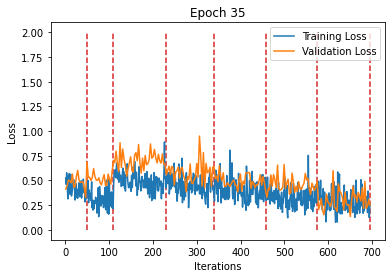

Train



Sequence:1, Seq Training Mean Loss: 0.15828181381026904, Seq Training Acc: 0.32916666666666666
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.15733313703288634, Seq Training Acc: 0.4317708333333333
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.4884525313973427, Seq Training Acc: 0.7635416666666667
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3982490492363771, Seq Training Acc: 0.7096354166666666
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.381495584299167, Seq Training Acc: 0.8236979166666667
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.32812935834129653, Seq Training Acc: 0.8135416666666667
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.2777842119336128, Seq Training Acc: 0.8791666666666667
******************************************************************
Epoch:36, Epoch Training Loss Mean: 0.37808215618133545, Epoch Acc: 1.5835069444444445
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.4290733505040407, Seq Val Acc: 0.798828125



******************************************************************
Sequence:2, Seq Mean Loss: 0.4857537433505058, Seq Val Acc: 0.7859375



******************************************************************
Sequence:3, Seq Mean Loss: 0.6480453252792359, Seq Val Acc: 0.64140625



******************************************************************
Sequence:4, Seq Mean Loss: 0.5630374736077076, Seq Val Acc: 0.7381756756756757



******************************************************************
Sequence:5, Seq Mean Loss: 0.4566366016864777, Seq Val Acc: 0.77890625



******************************************************************
Sequence:6, Seq Mean Loss: 0.4385170905213607, Seq Val Acc: 0.8050986842105263



******************************************************************
Sequence:7, Seq Mean Loss: 0.32849014960229395, Seq Val Acc: 0.840625
Epoch:36, Epoch Val Mean Loss: 0.48226478695869446, Epoch Val Acc: 1.4736979166666666
******************************************************************


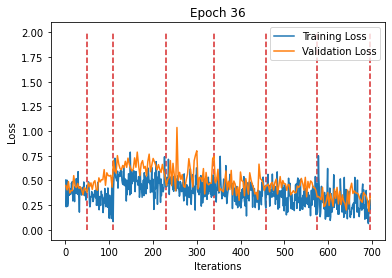

Train



Sequence:1, Seq Training Mean Loss: 0.14780548661947251, Seq Training Acc: 0.34140625
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.15835127532482146, Seq Training Acc: 0.42890625
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.4590642993648847, Seq Training Acc: 0.7872395833333333
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.4079101338982582, Seq Training Acc: 0.7088541666666667
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.3671574734151363, Seq Training Acc: 0.8341145833333333
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.32151428374151386, Seq Training Acc: 0.81875
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.26482526790350674, Seq Training Acc: 0.8776041666666666
******************************************************************
Epoch:37, Epoch Training Loss Mean: 0.36718761920928955, Epoch Acc: 1.5989583333333333
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.3822106970474124, Seq Val Acc: 0.80078125



******************************************************************
Sequence:2, Seq Mean Loss: 0.507879139482975, Seq Val Acc: 0.778125



******************************************************************
Sequence:3, Seq Mean Loss: 0.6401873305439949, Seq Val Acc: 0.6546875



******************************************************************
Sequence:4, Seq Mean Loss: 0.5389552462745357, Seq Val Acc: 0.7305743243243243



******************************************************************
Sequence:5, Seq Mean Loss: 0.4699033096432686, Seq Val Acc: 0.78828125



******************************************************************
Sequence:6, Seq Mean Loss: 0.46922087747799723, Seq Val Acc: 0.7911184210526315



******************************************************************
Sequence:7, Seq Mean Loss: 0.32276480868458746, Seq Val Acc: 0.8546875
Epoch:37, Epoch Val Mean Loss: 0.48207318782806396, Epoch Val Acc: 1.478125
******************************************************************


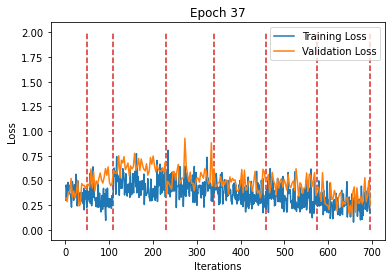

Train



Sequence:1, Seq Training Mean Loss: 0.15254662533601124, Seq Training Acc: 0.33880208333333334
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.15820013185342152, Seq Training Acc: 0.4315104166666667
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.4810882806777954, Seq Training Acc: 0.7747395833333334
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.39475632160902024, Seq Training Acc: 0.7221354166666667
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.3658818275978168, Seq Training Acc: 0.8393229166666667
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.32798844457914433, Seq Training Acc: 0.8223958333333333
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.26997862799714006, Seq Training Acc: 0.8802083333333334
******************************************************************
Epoch:38, Epoch Training Loss Mean: 0.37129902839660645, Epoch Acc: 1.6030381944444445
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.4342399947345257, Seq Val Acc: 0.8046875



******************************************************************
Sequence:2, Seq Mean Loss: 0.5213589027523995, Seq Val Acc: 0.7390625



******************************************************************
Sequence:3, Seq Mean Loss: 0.6564607813954353, Seq Val Acc: 0.63125



******************************************************************
Sequence:4, Seq Mean Loss: 0.5543497986084706, Seq Val Acc: 0.7339527027027027



******************************************************************
Sequence:5, Seq Mean Loss: 0.44338133186101913, Seq Val Acc: 0.809375



******************************************************************
Sequence:6, Seq Mean Loss: 0.44852947561364426, Seq Val Acc: 0.8116776315789473



******************************************************************
Sequence:7, Seq Mean Loss: 0.31186139918863776, Seq Val Acc: 0.85546875
Epoch:38, Epoch Val Mean Loss: 0.4822433888912201, Epoch Val Acc: 1.4791666666666667
******************************************************************


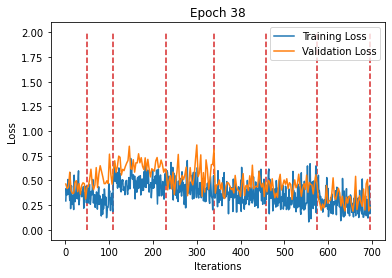

Train



Sequence:1, Seq Training Mean Loss: 0.1581900535772244, Seq Training Acc: 0.33958333333333335
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.15213625207543374, Seq Training Acc: 0.4328125
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.47050682455301285, Seq Training Acc: 0.7739583333333333
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3948139637708664, Seq Training Acc: 0.7221354166666667
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.38189587108790873, Seq Training Acc: 0.8296875
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.3121936998019616, Seq Training Acc: 0.828125
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.25557131562381985, Seq Training Acc: 0.8875
******************************************************************
Epoch:39, Epoch Training Loss Mean: 0.36695966124534607, Epoch Acc: 1.6046006944444444
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.3874310366809368, Seq Val Acc: 0.83984375



******************************************************************
Sequence:2, Seq Mean Loss: 0.4909677103161812, Seq Val Acc: 0.7890625



******************************************************************
Sequence:3, Seq Mean Loss: 0.6116749443113804, Seq Val Acc: 0.65546875



******************************************************************
Sequence:4, Seq Mean Loss: 0.5380225632641766, Seq Val Acc: 0.754222972972973



******************************************************************
Sequence:5, Seq Mean Loss: 0.47828602492809297, Seq Val Acc: 0.77890625



******************************************************************
Sequence:6, Seq Mean Loss: 0.426321657864671, Seq Val Acc: 0.819078947368421



******************************************************************
Sequence:7, Seq Mean Loss: 0.2517018197104335, Seq Val Acc: 0.9046875
Epoch:39, Epoch Val Mean Loss: 0.45797327160835266, Epoch Val Acc: 1.5151041666666667
******************************************************************


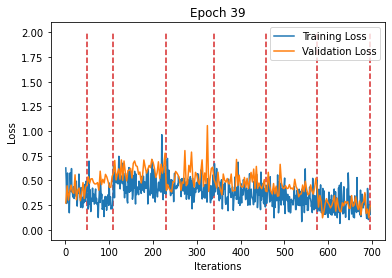

Train



Sequence:1, Seq Training Mean Loss: 0.14639040492475033, Seq Training Acc: 0.34401041666666665
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.151470784842968, Seq Training Acc: 0.43255208333333334
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.455483811100324, Seq Training Acc: 0.78359375
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.4051750309765339, Seq Training Acc: 0.715625
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.3727133472760518, Seq Training Acc: 0.8278645833333333
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.30912248361855743, Seq Training Acc: 0.83046875
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.2447227411903441, Seq Training Acc: 0.890625
******************************************************************
Epoch:40, Epoch Training Loss Mean: 0.36001357436180115, Epoch Acc: 1.6082465277777778
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.39743076637387276, Seq Val Acc: 0.8203125



******************************************************************
Sequence:2, Seq Mean Loss: 0.4955025017261505, Seq Val Acc: 0.7609375



******************************************************************
Sequence:3, Seq Mean Loss: 0.6339722625911236, Seq Val Acc: 0.66328125



******************************************************************
Sequence:4, Seq Mean Loss: 0.5852238221748455, Seq Val Acc: 0.7153716216216216



******************************************************************
Sequence:5, Seq Mean Loss: 0.42421944439411163, Seq Val Acc: 0.7890625



******************************************************************
Sequence:6, Seq Mean Loss: 0.4289644658565521, Seq Val Acc: 0.8092105263157895



******************************************************************
Sequence:7, Seq Mean Loss: 0.28127121962606905, Seq Val Acc: 0.87734375
Epoch:40, Epoch Val Mean Loss: 0.4666726589202881, Epoch Val Acc: 1.4895833333333333
******************************************************************


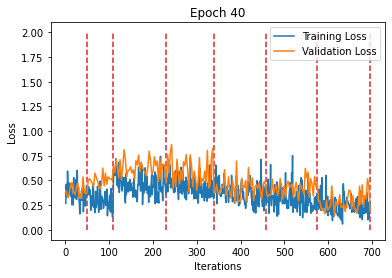

Train



Sequence:1, Seq Training Mean Loss: 0.141280439371864, Seq Training Acc: 0.3484375
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.14736577235162257, Seq Training Acc: 0.4359375
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.45141681308547654, Seq Training Acc: 0.7830729166666667
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3993087848027547, Seq Training Acc: 0.7153645833333333
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.38740965438385805, Seq Training Acc: 0.8205729166666667
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.2987226075182358, Seq Training Acc: 0.8296875
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.24778807299832503, Seq Training Acc: 0.8927083333333333
******************************************************************
Epoch:41, Epoch Training Loss Mean: 0.3579785227775574, Epoch Acc: 1.60859375
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.3993851952254772, Seq Val Acc: 0.810546875



******************************************************************
Sequence:2, Seq Mean Loss: 0.4758298024535179, Seq Val Acc: 0.7765625



******************************************************************
Sequence:3, Seq Mean Loss: 0.6438115820288658, Seq Val Acc: 0.66328125



******************************************************************
Sequence:4, Seq Mean Loss: 0.5376203462884233, Seq Val Acc: 0.7212837837837838



******************************************************************
Sequence:5, Seq Mean Loss: 0.41524630784988403, Seq Val Acc: 0.8109375



******************************************************************
Sequence:6, Seq Mean Loss: 0.4244744769836727, Seq Val Acc: 0.8083881578947368



******************************************************************
Sequence:7, Seq Mean Loss: 0.2786132900044322, Seq Val Acc: 0.8796875
Epoch:41, Epoch Val Mean Loss: 0.45643115043640137, Epoch Val Acc: 1.5005208333333333
******************************************************************


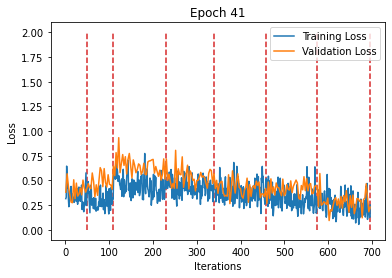

Train



Sequence:1, Seq Training Mean Loss: 0.13569883791108925, Seq Training Acc: 0.34921875
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.15039470369617144, Seq Training Acc: 0.43046875
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.45673829937974614, Seq Training Acc: 0.78046875
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.39985799392064414, Seq Training Acc: 0.71328125
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.3974248030533393, Seq Training Acc: 0.821875
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.31312394166986146, Seq Training Acc: 0.8255208333333334
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.2631092047318816, Seq Training Acc: 0.88359375
******************************************************************
Epoch:42, Epoch Training Loss Mean: 0.36541256308555603, Epoch Acc: 1.6014756944444444
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.35512639954686165, Seq Val Acc: 0.84765625



******************************************************************
Sequence:2, Seq Mean Loss: 0.48867491632699966, Seq Val Acc: 0.7578125



******************************************************************
Sequence:3, Seq Mean Loss: 0.618242084234953, Seq Val Acc: 0.6765625



******************************************************************
Sequence:4, Seq Mean Loss: 0.503810302631275, Seq Val Acc: 0.7525337837837838



******************************************************************
Sequence:5, Seq Mean Loss: 0.4073147252202034, Seq Val Acc: 0.8140625



******************************************************************
Sequence:6, Seq Mean Loss: 0.41301617496892024, Seq Val Acc: 0.8240131578947368



******************************************************************
Sequence:7, Seq Mean Loss: 0.3628911729902029, Seq Val Acc: 0.82734375
Epoch:42, Epoch Val Mean Loss: 0.4559698700904846, Epoch Val Acc: 1.5049479166666666
******************************************************************


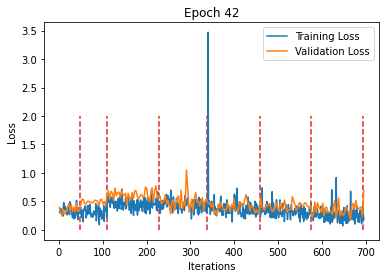

Train



Sequence:1, Seq Training Mean Loss: 0.1459947387377421, Seq Training Acc: 0.34427083333333336
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.1597461398690939, Seq Training Acc: 0.4239583333333333
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.4468680920700232, Seq Training Acc: 0.7796875
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.39965231716632843, Seq Training Acc: 0.71640625
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.3833063021302223, Seq Training Acc: 0.8268229166666666
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.30456126779317855, Seq Training Acc: 0.8291666666666667
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.2587125343581041, Seq Training Acc: 0.8864583333333333
******************************************************************
Epoch:43, Epoch Training Loss Mean: 0.36238986253738403, Epoch Acc: 1.6022569444444446
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.40342396683990955, Seq Val Acc: 0.83984375



******************************************************************
Sequence:2, Seq Mean Loss: 0.48595324009656904, Seq Val Acc: 0.7703125



******************************************************************
Sequence:3, Seq Mean Loss: 0.6338188864290715, Seq Val Acc: 0.65390625



******************************************************************
Sequence:4, Seq Mean Loss: 0.5264556005194381, Seq Val Acc: 0.7466216216216216



******************************************************************
Sequence:5, Seq Mean Loss: 0.4075763877481222, Seq Val Acc: 0.80625



******************************************************************
Sequence:6, Seq Mean Loss: 0.46329840311878606, Seq Val Acc: 0.7861842105263158



******************************************************************
Sequence:7, Seq Mean Loss: 0.3169572323560715, Seq Val Acc: 0.8625
Epoch:43, Epoch Val Mean Loss: 0.46576687693595886, Epoch Val Acc: 1.49375
******************************************************************


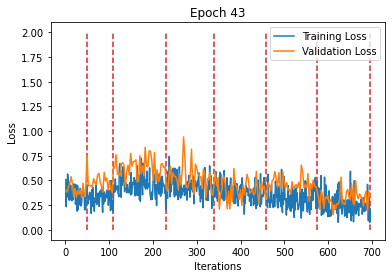

Train



Sequence:1, Seq Training Mean Loss: 0.1446045664449533, Seq Training Acc: 0.3424479166666667
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.1572704258064429, Seq Training Acc: 0.42552083333333335
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.4605279378592968, Seq Training Acc: 0.7765625
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.40028262411554655, Seq Training Acc: 0.7161458333333334
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.36802572732170424, Seq Training Acc: 0.8268229166666666
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.3193192474544048, Seq Training Acc: 0.82421875
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.25883241059879464, Seq Training Acc: 0.8872395833333333
******************************************************************
Epoch:44, Epoch Training Loss Mean: 0.3641202449798584, Epoch Acc: 1.5996527777777778
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.38608131371438503, Seq Val Acc: 0.818359375



******************************************************************
Sequence:2, Seq Mean Loss: 0.4754674047231674, Seq Val Acc: 0.7859375



******************************************************************
Sequence:3, Seq Mean Loss: 0.605988209694624, Seq Val Acc: 0.68203125



******************************************************************
Sequence:4, Seq Mean Loss: 0.5211160021859247, Seq Val Acc: 0.7423986486486487



******************************************************************
Sequence:5, Seq Mean Loss: 0.39667346216738225, Seq Val Acc: 0.834375



******************************************************************
Sequence:6, Seq Mean Loss: 0.4215454059211831, Seq Val Acc: 0.8133223684210527



******************************************************************
Sequence:7, Seq Mean Loss: 0.3429790448397398, Seq Val Acc: 0.8421875
Epoch:44, Epoch Val Mean Loss: 0.45373284816741943, Epoch Val Acc: 1.5127604166666666
******************************************************************


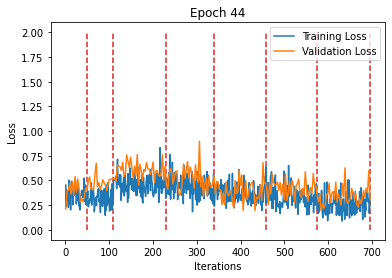

Train



Sequence:1, Seq Training Mean Loss: 0.14708872859676678, Seq Training Acc: 0.3372395833333333
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.16146630893150965, Seq Training Acc: 0.42473958333333334
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.46324260781208676, Seq Training Acc: 0.7807291666666667
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3908129889518023, Seq Training Acc: 0.7166666666666667
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.3682454320291678, Seq Training Acc: 0.83046875
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.2924805228287975, Seq Training Acc: 0.8338541666666667
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.26702309809625147, Seq Training Acc: 0.8809895833333333
******************************************************************
Epoch:45, Epoch Training Loss Mean: 0.36092543601989746, Epoch Acc: 1.6015625
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.3798736082389951, Seq Val Acc: 0.81640625



******************************************************************
Sequence:2, Seq Mean Loss: 0.4768970385193825, Seq Val Acc: 0.765625



******************************************************************
Sequence:3, Seq Mean Loss: 0.5747622519731521, Seq Val Acc: 0.69921875



******************************************************************
Sequence:4, Seq Mean Loss: 0.5057175844102293, Seq Val Acc: 0.7584459459459459



******************************************************************
Sequence:5, Seq Mean Loss: 0.3844909600913525, Seq Val Acc: 0.825



******************************************************************
Sequence:6, Seq Mean Loss: 0.42836757004261017, Seq Val Acc: 0.8001644736842105



******************************************************************
Sequence:7, Seq Mean Loss: 0.3211507435888052, Seq Val Acc: 0.8484375
Epoch:45, Epoch Val Mean Loss: 0.44078612327575684, Epoch Val Acc: 1.5145833333333334
******************************************************************


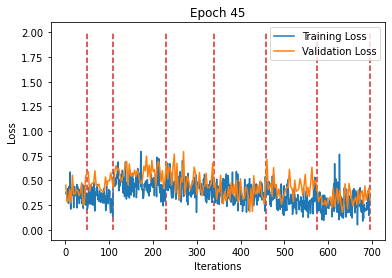

Train



Sequence:1, Seq Training Mean Loss: 0.14502328112721444, Seq Training Acc: 0.3416666666666667
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.15241457882026832, Seq Training Acc: 0.4348958333333333
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.4467976232369741, Seq Training Acc: 0.7864583333333334
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3859536699950695, Seq Training Acc: 0.7255208333333333
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.36934759890039764, Seq Training Acc: 0.8296875
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.3077950374533733, Seq Training Acc: 0.8229166666666666
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.23836921996747454, Seq Training Acc: 0.8932291666666666
******************************************************************
Epoch:46, Epoch Training Loss Mean: 0.3532145619392395, Epoch Acc: 1.6114583333333334
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.4207001542672515, Seq Val Acc: 0.798828125



******************************************************************
Sequence:2, Seq Mean Loss: 0.4409965708851814, Seq Val Acc: 0.815625



******************************************************************
Sequence:3, Seq Mean Loss: 0.6116781897842885, Seq Val Acc: 0.67734375



******************************************************************
Sequence:4, Seq Mean Loss: 0.49628428188530177, Seq Val Acc: 0.7652027027027027



******************************************************************
Sequence:5, Seq Mean Loss: 0.3903752215206623, Seq Val Acc: 0.81171875



******************************************************************
Sequence:6, Seq Mean Loss: 0.4148412425267069, Seq Val Acc: 0.8149671052631579



******************************************************************
Sequence:7, Seq Mean Loss: 0.36799989454448223, Seq Val Acc: 0.82890625
Epoch:46, Epoch Val Mean Loss: 0.4522933065891266, Epoch Val Acc: 1.5091145833333333
******************************************************************


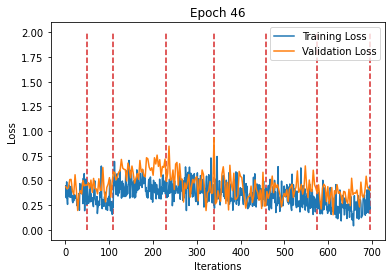

Train



Sequence:1, Seq Training Mean Loss: 0.14477270717422167, Seq Training Acc: 0.3375
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.15493815739949543, Seq Training Acc: 0.43125
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.47304696465531987, Seq Training Acc: 0.7744791666666667
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.39631751279036204, Seq Training Acc: 0.7174479166666666
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.3832352586090565, Seq Training Acc: 0.8153645833333333
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.3070499730606874, Seq Training Acc: 0.82578125
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.26095236086597046, Seq Training Acc: 0.884375
******************************************************************
Epoch:47, Epoch Training Loss Mean: 0.36609721183776855, Epoch Acc: 1.5953993055555555
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.38602594658732414, Seq Val Acc: 0.828125



******************************************************************
Sequence:2, Seq Mean Loss: 0.45537155866622925, Seq Val Acc: 0.7734375



******************************************************************
Sequence:3, Seq Mean Loss: 0.5735366687178611, Seq Val Acc: 0.6984375



******************************************************************
Sequence:4, Seq Mean Loss: 0.4810314114029343, Seq Val Acc: 0.7609797297297297



******************************************************************
Sequence:5, Seq Mean Loss: 0.39575903192162515, Seq Val Acc: 0.82421875



******************************************************************
Sequence:6, Seq Mean Loss: 0.4400811971802461, Seq Val Acc: 0.7894736842105263



******************************************************************
Sequence:7, Seq Mean Loss: 0.39719220660626886, Seq Val Acc: 0.815625
Epoch:47, Epoch Val Mean Loss: 0.45222777128219604, Epoch Val Acc: 1.5033854166666667
******************************************************************


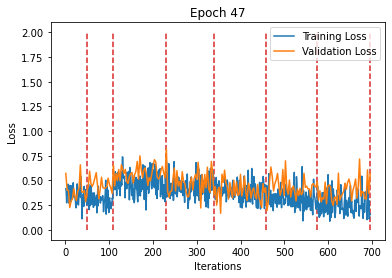

Train



Sequence:1, Seq Training Mean Loss: 0.14565964167316756, Seq Training Acc: 0.34036458333333336
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.14701543400684994, Seq Training Acc: 0.43463541666666666
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.46723016500473025, Seq Training Acc: 0.7716145833333333
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.40767725693682827, Seq Training Acc: 0.7046875
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.367184583346049, Seq Training Acc: 0.8390625
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.3251741025596857, Seq Training Acc: 0.815625
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.25548123233020303, Seq Training Acc: 0.8815104166666666
******************************************************************
Epoch:48, Epoch Training Loss Mean: 0.3652527928352356, Epoch Acc: 1.5958333333333334
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.3649890460073948, Seq Val Acc: 0.8359375



******************************************************************
Sequence:2, Seq Mean Loss: 0.4727931469678879, Seq Val Acc: 0.7734375



******************************************************************
Sequence:3, Seq Mean Loss: 0.5613260067999363, Seq Val Acc: 0.70703125



******************************************************************
Sequence:4, Seq Mean Loss: 0.45405370802492706, Seq Val Acc: 0.7635135135135135



******************************************************************
Sequence:5, Seq Mean Loss: 0.4058041971176863, Seq Val Acc: 0.81875



******************************************************************
Sequence:6, Seq Mean Loss: 0.4420119461260344, Seq Val Acc: 0.8067434210526315



******************************************************************
Sequence:7, Seq Mean Loss: 0.35606037378311156, Seq Val Acc: 0.8375
Epoch:48, Epoch Val Mean Loss: 0.44077813625335693, Epoch Val Acc: 1.5190104166666667
******************************************************************


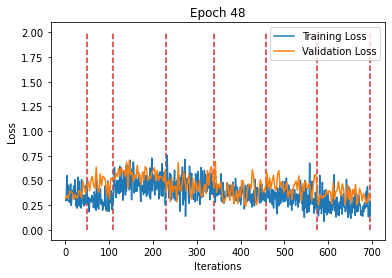

Train



Sequence:1, Seq Training Mean Loss: 0.13572001382708548, Seq Training Acc: 0.34479166666666666
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.15219305629531543, Seq Training Acc: 0.43203125
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.46911791935563085, Seq Training Acc: 0.7716145833333333
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.37974774787823357, Seq Training Acc: 0.72578125
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.36676576447983583, Seq Training Acc: 0.834375
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.30336240902543066, Seq Training Acc: 0.8325520833333333
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.24674111995846032, Seq Training Acc: 0.8888020833333333
******************************************************************
Epoch:49, Epoch Training Loss Mean: 0.3545866906642914, Epoch Acc: 1.609982638888889
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.4229734893888235, Seq Val Acc: 0.783203125



******************************************************************
Sequence:2, Seq Mean Loss: 0.4515769764780998, Seq Val Acc: 0.8078125



******************************************************************
Sequence:3, Seq Mean Loss: 0.5803856730461121, Seq Val Acc: 0.70625



******************************************************************
Sequence:4, Seq Mean Loss: 0.48695602771398183, Seq Val Acc: 0.7576013513513513



******************************************************************
Sequence:5, Seq Mean Loss: 0.3761499412357807, Seq Val Acc: 0.81953125



******************************************************************
Sequence:6, Seq Mean Loss: 0.43815043019621, Seq Val Acc: 0.803453947368421



******************************************************************
Sequence:7, Seq Mean Loss: 0.3892023678869009, Seq Val Acc: 0.82109375
Epoch:49, Epoch Val Mean Loss: 0.4514966309070587, Epoch Val Acc: 1.509375
******************************************************************


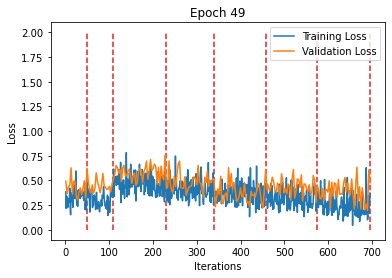

Train



Sequence:1, Seq Training Mean Loss: 0.14228757470846176, Seq Training Acc: 0.33697916666666666
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.15932158169647057, Seq Training Acc: 0.43072916666666666
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.44891937971115115, Seq Training Acc: 0.7799479166666666
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.4072577261676391, Seq Training Acc: 0.7143229166666667
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.3653581976890564, Seq Training Acc: 0.8333333333333334
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.30151536713043847, Seq Training Acc: 0.83515625
******************************************************************



Sequence:7, Seq Training Mean Loss: 0.2606858103225628, Seq Training Acc: 0.8752604166666667
******************************************************************
Epoch:50, Epoch Training Loss Mean: 0.3600596785545349, Epoch Acc: 1.6019097222222223
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Mean Loss: 0.3365170434117317, Seq Val Acc: 0.857421875



******************************************************************
Sequence:2, Seq Mean Loss: 0.464910052716732, Seq Val Acc: 0.765625



******************************************************************
Sequence:3, Seq Mean Loss: 0.5621828906238079, Seq Val Acc: 0.71796875



******************************************************************
Sequence:4, Seq Mean Loss: 0.447494121822151, Seq Val Acc: 0.7787162162162162



******************************************************************
Sequence:5, Seq Mean Loss: 0.3651332799345255, Seq Val Acc: 0.83671875



******************************************************************
Sequence:6, Seq Mean Loss: 0.472661712451985, Seq Val Acc: 0.7886513157894737



******************************************************************
Sequence:7, Seq Mean Loss: 0.4081301189959049, Seq Val Acc: 0.80859375
Epoch:50, Epoch Val Mean Loss: 0.44423699378967285, Epoch Val Acc: 1.51953125
******************************************************************


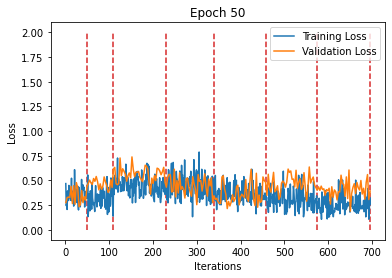


Save Model


TypeError: forward() takes 3 positional arguments but 4 were given

In [30]:
if run_train:
    #writer = SummaryWriter('runs/Regenerated_Type2_Dataset_Experiment_lr' + str(lr) + '_' + timestampStr)
    writer = SummaryWriter('runs/008_Experiment_3stripe_720x24_lr' + str(lr) + '_' + timestampStr)
    max_iter_per_seq = 120
    # 训练迭代总步数
    num_train_iter_per_epoch = 0
    num_train_iterations = [] # For plot parting line
    for seq_dataloaders in dataloaders:
        if len(seq_dataloaders[train_dl_idx]) <= max_iter_per_seq:
            num_train_iter_per_epoch += len(seq_dataloaders[train_dl_idx])
        else:
            num_train_iter_per_epoch += max_iter_per_seq
        num_train_iterations.append(num_train_iter_per_epoch)
    print("Total Train Iterations: ",num_train_iter_per_epoch)
    print("Total Train Iterations List: ",num_train_iterations)
        
    # 训练迭代总步数为验证迭代总步数的3倍
    num_val_iterations = [int(number / 3) for number in num_train_iterations]
    num_val_iter_per_epoch = num_val_iterations[-1]
    
    # iterations in every seq
    num_val_iter_per_seq = []
    num_val_iter_per_seq.append(num_val_iterations[0])
    for i in range(len(num_val_iterations)-1):
        diff = num_val_iterations[i+1] - num_val_iterations[i] # The latter minus the former
        num_val_iter_per_seq.append(diff)
        
    print(num_val_iter_per_seq)
        
    optimizer = torch.optim.Adam(model.parameters(),lr=lr,eps=1e-08)

    scheduler = OneCycleLR(optimizer, num_train_iter_per_epoch, num_epochs, min_lr_factor=min_lr_factor)
    scheduler.step(epoch=0)
    
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.
    loss_min = 0.
    
    for epoch in tqdm(range(1,num_epochs+1)):

        print('Train')

        model.train()
        
        running_corrects = 0

        train_loss_array = np.zeros(num_train_iter_per_epoch, dtype=np.single)

        # mse_y = torch.zeros(batch_sizes[0]//2).to(device)
        
        i = 0
        seq_idx = 1
        for (refs, train_dl) in zip(refs_list,train_dls):
            # obtain the refs in every seq
            
            curr_train_dl = train_dl

            curr_refs = refs.float().to(device)

            # Training
            dl_iter = iter(curr_train_dl)
            
            # This two only used to compute the loss and acc in every Sequence
            running_loss = 0
            corrects = 0
            for idx in tqdm(range(len(curr_train_dl))):
                if idx >= max_iter_per_seq:
                    break
                try:
                    img1, img2, targets = next(dl_iter)

                except (StopIteration, TypeError):
                    dl_iter = iter(curr_train_dl)
                    img1, img2, targets = next(dl_iter)
                
                scheduler.zero_grad()

                img1 = img1.float().to(device)
                img2 = img2.float().to(device)
                targets = targets.view(-1)
                targets = targets.float().to(device)

                # forward pass
                loss, preds = model.compute_loss(img1, img2, curr_refs, targets)
                
                loss.backward()
                
                running_loss += loss.item()
                corrects += torch.sum(preds == targets)
                running_corrects += torch.sum(preds == targets)

                train_loss_array[i] = loss.cpu().detach().numpy()
               
                
                # record loss and accuracy per iteration
                c = torch.sum(preds == targets)
                acc = int(c) / img1.size(0)
                writer.add_scalar('Train/Loss per Iteration',train_loss_array[i], ((epoch - 1) * num_train_iter_per_epoch)+ i)
                writer.add_scalar('Train/Acc per Iteration',acc, ((epoch - 1) * num_train_iter_per_epoch)+ i)
                
                # Record the lr
                curr_lr = get_lr(optimizer)
                writer.add_scalar('Train/Learning Rate',curr_lr , ((epoch - 1) * num_train_iter_per_epoch)+ i)
                
                i += 1
                scheduler.step()
            
            # record loss and accuracy in every train dataloader (namely every Sequence)
            #seq_train_mean_loss = running_loss / len(curr_train_dl)
            #seq_train_acc = int(corrects) / (len(curr_train_dl) * img1.size(0))
            seq_train_mean_loss = running_loss / max_iter_per_seq
            seq_train_acc = int(corrects) / (max_iter_per_seq * img1.size(0))
            
            print("Sequence:{}, Seq Training Mean Loss: {}, Seq Training Acc: {}".format(seq_idx, seq_train_mean_loss, seq_train_acc))
            print("******************************************************************")
            # Record the loss and acc in every Seq in Tensorboard
            writer.add_scalar('Train/Seq Training Mean Loss',seq_train_mean_loss, (epoch - 1) * len(train_dls) + seq_idx)
            writer.add_scalar('Train/Seq Training Accuracy', seq_train_acc, (epoch - 1) * len(train_dls) + seq_idx)
            writer.add_scalar('Train/Seq Error Rate',1 - seq_train_acc, (epoch - 1) * len(train_dls) + seq_idx)
            
            seq_idx += 1
            
        # after one epoch update scheduler   
        # Plot lr policy
        curr_lr = get_lr(optimizer)
        writer.add_scalar('Train/Learning Rate Policy',curr_lr , epoch)
        writer.flush()
            
        # record loss and accuracy in every epoch (namely 6 Sequences)
        epoch_train_mean_loss = train_loss_array.mean()  # std
        epoch_train_acc = int(running_corrects) / (max_iter_per_seq* 3 * img1.size(0))

        print("Epoch:{}, Epoch Training Loss Mean: {}, Epoch Acc: {}".format(epoch, epoch_train_mean_loss, epoch_train_acc))
        print("******************************************************************")
        
        ### Validation
        print('Validation')
        model.eval()
        val_loss_array = np.zeros(num_val_iter_per_epoch, dtype=np.single)
        
        running_corrects = 0

        i = 0
        with torch.no_grad():
            seq_idx = 1
            for (refs, valid_dl, max_num) in zip(refs_list,valid_dls, num_val_iter_per_seq):
                
                curr_valid_dl = valid_dl
                curr_refs = refs.float().to(device)
                iter_max_num = max_num
            
                dl_iter = iter(curr_valid_dl)
                # This two uesd to compute loss and accurary in every Seq
                running_loss = 0
                corrects = 0
                for dl_idx in tqdm(range(iter_max_num)):
                    try:
                        img1, img2, targets = next(dl_iter)
                    except (StopIteration, TypeError):
                        dl_iter = iter(curr_valid_dl)
                        img1, img2, targets = next(dl_iter)
                    
                    scheduler.zero_grad()

                    img1 = img1.float().to(device)
                    img2 = img2.float().to(device)
                    targets = targets.view(-1)
                    targets = targets.float().to(device)
                
                    loss, preds = model.compute_loss(img1, img2, curr_refs, targets)
                    
                    running_loss += loss.item()
                    corrects += torch.sum(preds == targets)
                    running_corrects += torch.sum(preds == targets)
                    
                    # record loss and accuracy in every iteration
                    c = torch.sum(preds == targets)
                    acc = int(c) / img1.size(0)
                    writer.add_scalar('Validation/Loss per Iteration',loss.item(), ((epoch - 1) * num_val_iter_per_epoch)+ i)
                    writer.add_scalar('Validation/Acc per Iteration',acc, ((epoch - 1) * num_val_iter_per_epoch)+ i)

                    val_loss_array[i] = loss.cpu().detach().numpy()
                    i += 1
            
                #seq_val_mean_loss = running_loss / len(curr_valid_dl)
                #seq_val_acc = int(corrects) / (len(curr_valid_dl) * img1.size(0))
                seq_val_mean_loss = running_loss / iter_max_num
                seq_val_acc = int(corrects) / (iter_max_num * img1.size(0))
                print("******************************************************************")
                print("Sequence:{}, Seq Mean Loss: {}, Seq Val Acc: {}".format(seq_idx,seq_val_mean_loss, seq_val_acc))
                
                writer.add_scalar('Validation/Seq Mean Loss',seq_val_mean_loss, (epoch - 1) * len(valid_dls) + seq_idx)
                writer.add_scalar('Validation/Seq Accuracy', seq_val_acc, (epoch - 1) * len(valid_dls) + seq_idx)
                writer.add_scalar('Validation/Seq Error Rate',1 - seq_val_acc, (epoch - 1) * len(valid_dls) + seq_idx)
                
                seq_idx += 1
                
            epoch_val_mean_loss = val_loss_array.mean()  # std
            epoch_val_acc = int(running_corrects) / (iter_max_num*3 * img1.size(0))

            print("Epoch:{}, Epoch Val Mean Loss: {}, Epoch Val Acc: {}".format(epoch, epoch_val_mean_loss, epoch_val_acc))
            print("******************************************************************")
            
        # save best model weights
        if epoch_val_acc > best_acc:
            best_model_wts = copy.deepcopy(model.state_dict())
            loss_min = epoch_val_mean_loss
            
        # Tensorboard
        writer.add_scalars('Epoch/Loss', {"Training Loss": epoch_train_mean_loss,
                                          "Validation Loss": epoch_val_mean_loss}, epoch)
        writer.add_scalars('Epoch/Accuracy', {"Training Accuracy":epoch_train_acc,
                                              "Validation Accuracy": epoch_val_acc}, epoch)
        writer.add_scalars('Epoch/Error Rate', {"Training": 1 - epoch_train_acc,
                                                "Validation": 1 - epoch_val_acc}, epoch)
        writer.flush()
        
        plt.plot(np.linspace(1, train_loss_array.size+1, train_loss_array.size), train_loss_array,label='Training Loss')
        plt.plot(np.linspace(1, train_loss_array.size+1, val_loss_array.size), val_loss_array, label='Validation Loss')
        
        train_parting_line = num_train_iterations  # 1128 iterations in total in training
        val_parting_line = num_val_iterations  # 373 iterations in total in validation
        plt.vlines(train_parting_line, 0, 2, colors = "tab:red", linestyles = "dashed")
        #plt.vlines(val_parting_line, 0, 2, colors = "tab:orange", linestyles = "dashed")
        
        plt.title('Epoch {}'.format(epoch))
        plt.xlabel('Iterations')
        plt.ylabel('Loss')
        plt.legend(loc='upper right')
        plt.show()
        
    print("Save Model")
    torch.save(model, net_path + '/m-' + timestampStr)
    torch.save({'epoch': epoch, 
                'state_dict': best_model_wts, 
                'best_loss': loss_min,
                'optimizer': optimizer.state_dict()},
                net_path + '/m-' + timestampStr + '-' + str("%.4f" % loss_min) + '.pth.tar')
    # add model to tensorboard
    writer.add_graph(model,(img1, curr_refs, targets))
    writer.flush()

    print('Finished Training')
        

### Valid Config

In [31]:
batch_size = 32
valid_dl_idx = 1
num_test_iter_per_epoch = 0
for seq_dataloaders in dataloaders:
    num_test_iter_per_epoch += len(seq_dataloaders[valid_dl_idx])
    
model.eval()
y_vect = np.zeros(batch_size * num_test_iter_per_epoch)
y_tilde_vect = np.zeros(batch_size * num_test_iter_per_epoch)

i = 0
with torch.no_grad():
    seq_idx = 1
    
    running_corrects = 0

    test_loss_array = np.zeros(num_test_iter_per_epoch, dtype=np.single)
    
    for (refs, test_dl) in zip(refs_list,valid_dls):
        
        curr_test_dl = test_dl
        
        curr_refs = refs.float().to(device) 

        dl_iter = iter(curr_test_dl)
        
        # This two uesd to compute loss and accurary in every Seq
        running_loss = 0
        corrects = 0

        for dl_idx in tqdm(range(len(curr_test_dl))):
            try:
                img1, img2, targets = next(dl_iter)
            except (StopIteration, TypeError):
                dl_iter = iter(curr_valid_dl)
                img1, img2, targets = next(dl_iter)

            scheduler.zero_grad()
            img1 = img1.float().to(device)
            img2 = img2.float().to(device)
            targets = targets.view(-1)
            targets = targets.float().to(device)
              
            loss, preds = model.compute_loss(img1, img2, curr_refs, targets)
                    
            running_loss += loss.item()
            corrects += torch.sum(preds == targets)
            
            test_loss_array[i] = loss.cpu().detach().numpy()

            y_vect[i*batch_size:(i+1)*batch_size] = targets.detach().cpu().numpy()
            y_tilde_vect[i*batch_size:(i+1)*batch_size] = preds.detach().cpu().numpy()
            
            # record loss and accuracy per iteration
            c = torch.sum(preds == targets)
            acc = int(c) / img1.size(0)
            
            writer.add_scalar('Test/Loss per Iteration',test_loss_array[i], i)
            writer.add_scalar('Test/Acc per Iteration',acc, i)
            writer.add_scalar('Test/Error Rate', 1 - acc, i)

            i += 1
        # record seq test loss and acc
        seq_test_mean_loss = running_loss / len(curr_test_dl)
        seq_test_acc = int(corrects) / (len(curr_test_dl) * img1.size(0))
        
        print("******************************************************************")
        print("Test: Sequence:{}, Seq Mean Loss: {}, Seq Acc: {}".format(seq_idx,seq_test_mean_loss, seq_test_acc))
            
        writer.add_scalar('Test/Seq Loss', seq_test_mean_loss, seq_idx)
        writer.add_scalar('Test/Seq Accuracy', seq_test_acc, seq_idx)
        writer.add_scalar('Test/Seq Error Rate', 1 - seq_test_acc, seq_idx)
        
        seq_idx += 1

writer.close()
                                      
print("Test finished")


******************************************************************
Test: Sequence:1, Seq Mean Loss: 0.38797316948572796, Seq Acc: 0.8541666666666666



******************************************************************
Test: Sequence:2, Seq Mean Loss: 0.42355577150980633, Seq Acc: 0.8208333333333333



******************************************************************
Test: Sequence:3, Seq Mean Loss: 0.5345219629151481, Seq Acc: 0.7247023809523809



******************************************************************
Test: Sequence:4, Seq Mean Loss: 0.48028437738065366, Seq Acc: 0.7592592592592593



******************************************************************
Test: Sequence:5, Seq Mean Loss: 0.3902323767542839, Seq Acc: 0.8134765625



******************************************************************
Test: Sequence:6, Seq Mean Loss: 0.42666024072416897, Seq Acc: 0.8146551724137931



******************************************************************
Test: Sequence:7, Seq Mean Loss: 0.41807782430859175, Seq Acc: 0.7931985294117647
Test finished


### Init test dataset for plotting degradation metrics 

In [78]:
def init_test_dataset(path,seq_idx_list,mean_val,std_val):

    ds_h5 = []
    refs_list = []

    img_transforms = [RandomRotateGrayscale(rot_range=[-0.1, 0.1], fill=150),
                      RandomFlip(lr_prob=0.5, ud_prob=0.5),
                      transforms.ToTensor(),
                      transforms.Normalize((mean_val,),(std_val,))]
    
    composed_img_transforms = transforms.Compose(img_transforms)
    
    # to obtain the Seq data
    for seq_idx in seq_idx_list:
        h5_fpath = path.format(seq_idx)
        h5_f = DatasetH5ForTest(h5_fpath, num_ref = 32, normalize_im=False, transform = composed_img_transforms)
        
        # obtain the references, the first 32 images in every Seq.
        refs = h5_f.getRef()
        refs_list.append(refs)
        
        ds_h5.append(h5_f)

    return refs_list, ds_h5

In [79]:
data_path_type1 = "../MA/NewData/22008_1000202026_652510007"
fnames_type1 = "Padding_regenerated_roi_ms1_seq{}_720x24.h5" # 0,1,2,3,4,5,6
combined_path_type1 = os.path.join(data_path_type1, fnames_type1)
seq_idx_list_type1 = [0,1,2,3,4,5,6]

inputs_shape = [1,720,24]
mean_val = 0
std_val = 255

refs_list, ds_h5_test = init_test_dataset(combined_path_type1,seq_idx_list_type1,mean_val,std_val)

In [80]:
ds_h5_test

Init Dataloader for degradation value

In [81]:
batch_size = 1
test_dataloaders = []
for ds in ds_h5_test: 
    test_dataloader = DataLoader(dataset = ds, batch_size=batch_size, shuffle = False)
    test_dataloaders.append(test_dataloader)

### Degradation metrics function

In [82]:
def degradation_metrics(v1, refs_tensor):
    r"""Calculate distance between vector of img1&img2 and each reference images
    Args:
        v1 (Tensor, torch.Size[batchsize,128]): batch of imgs from feature extractor
        
        refs_vectors(List of Tensor, torch.Size([1,128])): List of 10 refs vectors
    """
    v_dim = v1.size(1) # 128
    num_ref = refs_tensor.size(0)

    v11 = v1.unsqueeze(1).repeat(1, num_ref, 1)
    refs = refs_tensor.unsqueeze(0).repeat(v1.size(0), 1, 1)  #v1.size(0) = batch size
    
    kernel_matrix1 = (v11-refs).pow(2).sum(2) 
    
    metric = torch.mean(kernel_matrix1,dim = 1) 

    return metric

In [83]:
all_seq_y_tilde_vect = np.zeros(0)
time_ids = []
seq_idx = 0
for refs,dl in zip(refs_list, test_dataloaders):

    curr_refs = refs.float().to(device)
    num_data = len(dl)
    print(num_data)
    
    loss_vect = np.zeros(num_data)
    var_res_vect= np.zeros(num_data)

    y_vect = np.zeros(num_data)
    y_tilde_vect = np.zeros(num_data)
    
    dl_iter = iter(dl)

    for i in tqdm(range(num_data)):
        try:
            img,label = next(dl_iter)

        except (StopIteration, TypeError):
            dl_iter = iter(curr_train_dl)
            img,label = next(dl_iter)
            
        y_vect[i] = label
        
        img = img.float().to(device)
                
        #targets = targets.float().to(device)
        
        #v1, refs_v = model.forward_test(img, curr_refs)
        #metric = degradation_metrics(v1,refs_v)
        
        metric = model.forward(img, curr_refs)
        
        y_tilde = metric.detach().cpu().numpy()

        var_res_vect[i] = np.var(y_tilde)

        y_tilde_vect[i] = y_tilde.mean()

        loss_vect[i] = np.abs(label - y_tilde_vect[i])
        
    
    time_ids.append(y_tilde_vect.size)
    mov_aver = pd.Series(y_tilde_vect).rolling(32, min_periods=1).mean()
    rel_outlier_idx = np.abs(y_tilde_vect - mov_aver) > 3
    np.save('3stripes_720x24_outlier_{}.npy'.format(seq_idx), rel_outlier_idx)
    seq_idx += 1
        
    all_seq_y_tilde_vect = np.concatenate((all_seq_y_tilde_vect, y_tilde_vect))

1969



2427



6797



4402



5199



4658



5554


<IPython.core.display.Javascript object>


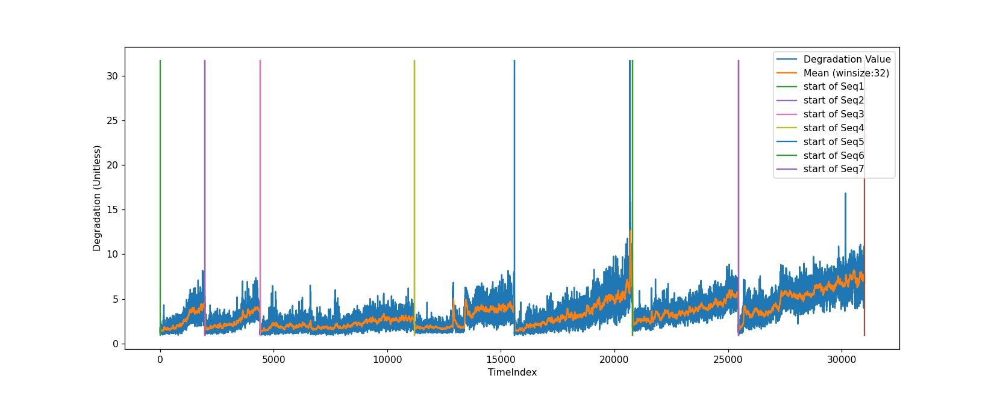

In [84]:
%matplotlib notebook
plt.plot(all_seq_y_tilde_vect, label='Degradation Value')
plt.plot(pd.Series(all_seq_y_tilde_vect).rolling(32).mean(), label='Mean (winsize:32)')

min_y = all_seq_y_tilde_vect.min()
max_y = all_seq_y_tilde_vect.max()

'''
# Type 1 Data with 10 refs
seq_period_iloc = [
    [    0,  1991],
    [ 1991, 4440],
    [ 4440, 11259],
    [ 11259, 15683],
    [ 15683, 20904],
    [ 20904, 25584],
    [ 25584, 31160],
]
'''
# Type 1 Data with 32 refs
seq_period_iloc = [
    [    0,  1969],
    [ 1969,  4396],
    [ 4396, 11193],
    [ 11193, 15595],
    [ 15595, 20794],
    [ 20794, 25452],
    [ 25452, 31006],
]

seq_index = 1
for stime_iloc, etime_iloc in seq_period_iloc:
    plt.plot([stime_iloc, stime_iloc], [min_y, max_y], label = "start of Seq{}".format(seq_index))
    plt.plot([etime_iloc, etime_iloc], [min_y, max_y])
    seq_index += 1


plt.ylabel("Degradation (Unitless)")
plt.xlabel("TimeIndex")

plt.legend()
plt.show()

In [85]:
import plotly.graph_objects as go

fig = go.Figure()

plot_raw_pts = True
    
fig.add_trace(
    go.Scatter(
        x=np.arange(all_seq_y_tilde_vect.size),
        y=all_seq_y_tilde_vect,
        mode='lines',
        name = 'Degradation Metric',
        #mode='lines+markers',
    )
)

fig.add_trace(
    go.Scatter(
        x=np.arange(all_seq_y_tilde_vect.size),
        y=pd.Series(all_seq_y_tilde_vect).rolling(32).mean(),
        mode='lines',
        name = 'Mean(Windowsize:32)',
        #mode='lines+markers',
    )
)

In [86]:
import plotly.offline as pyo
import plotly.graph_objs as go
# Set notebook mode to work in offline
pyo.init_notebook_mode()
# Create traces
trace0 = go.Scatter(
            x=np.arange(all_seq_y_tilde_vect.size),
            y=all_seq_y_tilde_vect,
            mode='lines',
            name = 'Degradation Metric',
            #mode='lines+markers',
            )

trace1 = go.Scatter(
            x=np.arange(all_seq_y_tilde_vect.size),
            y=pd.Series(all_seq_y_tilde_vect).rolling(32).mean(),
            mode='lines',
            name = 'Mean(Windowsize:32)',
            #mode='lines+markers',
            )

# Fill out data with our traces
data = [trace0, trace1]
# Plot it and save as basic-line.html
pyo.iplot(data, filename = 'basic-line')

# Finde Outliers

In [87]:
all_seq_y_tilde_vect.size

31006

In [93]:
mov_aver = pd.Series(all_seq_y_tilde_vect).rolling(32, min_periods=1).mean()
rel_outlier_idx = np.abs(all_seq_y_tilde_vect - mov_aver) > 3

In [94]:
res = all_seq_y_tilde_vect - mov_aver

In [95]:
res[0]

0.0

In [96]:
trace0 = go.Scatter(
            x=np.arange(all_seq_y_tilde_vect.size),
            y=res,
            mode='lines',
            name='Subtract the mean',
            #mode='lines+markers',
    )



trace1 = go.Scatter(
            x= np.arange(all_seq_y_tilde_vect.size),
            y= np.linspace(3, 3,all_seq_y_tilde_vect.size),
            mode='lines',
            name = 'Threshold',
            #mode='lines+markers',
            )

trace2 = go.Scatter(
            x= np.arange(all_seq_y_tilde_vect.size),
            y= np.linspace(-3,-3,all_seq_y_tilde_vect.size),
            mode='lines',
            name = 'Threshold',
            #mode='lines+markers',
            )

# Fill out data with our traces
data = [trace0, trace1,trace2]
# Plot it and save as basic-line.html
pyo.iplot(data, filename = 'basic-line')

In [97]:
outliers = np.where(abs(res) > 3, True, res)

In [98]:
index = np.argwhere(outliers == True)

In [99]:
index.size

143

# Test After clean outliers

In [105]:
data_path_type1 = "../MA/NewData/22008_1000202026_652510007"
fnames_type1 = "CleanOutliers_Padding_roi_seq{}_720x24.h5" # 0,1,2,3,4,5,6
combined_path_type1 = os.path.join(data_path_type1, fnames_type1)
seq_idx_list_type1 = [0,1,2,3,4,5,6]

inputs_shape = [1,720,24]
mean_val = 0
std_val = 255

refs_list, ds_h5_test = init_test_dataset(combined_path_type1,seq_idx_list_type1,mean_val,std_val)

In [106]:
batch_size = 1
test_dataloaders = []
for ds in ds_h5_test: 
    test_dataloader = DataLoader(dataset = ds, batch_size=batch_size, shuffle = False)
    test_dataloaders.append(test_dataloader)

In [107]:
all_seq_y_tilde_vect = np.zeros(0)
time_ids = []
seq_idx = 0
for refs,dl in zip(refs_list, test_dataloaders):

    curr_refs = refs.float().to(device)
    num_data = len(dl)
    print(num_data)
    
    loss_vect = np.zeros(num_data)
    var_res_vect= np.zeros(num_data)

    y_vect = np.zeros(num_data)
    y_tilde_vect = np.zeros(num_data)
    
    dl_iter = iter(dl)

    for i in tqdm(range(num_data)):
        try:
            img,label = next(dl_iter)

        except (StopIteration, TypeError):
            dl_iter = iter(curr_train_dl)
            img,label = next(dl_iter)
            
        y_vect[i] = label
        
        img = img.float().to(device)
                
        #targets = targets.float().to(device)
        
        #v1, refs_v = model.forward_test(img, curr_refs)
        #metric = degradation_metrics(v1,refs_v)
        
        metric = model.forward(img, curr_refs)
        
        y_tilde = metric.detach().cpu().numpy()

        var_res_vect[i] = np.var(y_tilde)

        y_tilde_vect[i] = y_tilde.mean()

        loss_vect[i] = np.abs(label - y_tilde_vect[i])
        
    time_ids.append(y_tilde_vect.size)
    mov_aver = pd.Series(y_tilde_vect).rolling(32, min_periods=1).mean()
    rel_outlier_idx = np.abs(y_tilde_vect - mov_aver) > 3
    np.save('3stripes_No720x30_outlier_{}.npy'.format(seq_idx), rel_outlier_idx)
    seq_idx += 1
        
    all_seq_y_tilde_vect = np.concatenate((all_seq_y_tilde_vect, y_tilde_vect))

1966



2422



6788



4390



4986



4651



5531


In [108]:
all_seq_y_tilde_vect.size

30734

In [109]:
import plotly.offline as pyo
import plotly.graph_objs as go
# Set notebook mode to work in offline
pyo.init_notebook_mode()
# Create traces
trace0 = go.Scatter(
            x=np.arange(all_seq_y_tilde_vect.size),
            y=all_seq_y_tilde_vect,
            mode='lines',
            name = 'Degradation Metric',
            #mode='lines+markers',
            )

trace1 = go.Scatter(
            x=np.arange(all_seq_y_tilde_vect.size),
            y=pd.Series(all_seq_y_tilde_vect).rolling(32).mean(),
            mode='lines',
            name = 'Mean(Windowsize:32)',
            #mode='lines+markers',
            )

# Fill out data with our traces
data = [trace0, trace1]
# Plot it and save as basic-line.html
pyo.iplot(data, filename = 'basic-line')